<a href="https://colab.research.google.com/github/vsermoud/Introduction-to-Classical-DFT/blob/main/HowToBegin_DFT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to begin

This tutorial will describe how to set up a cDFT algorithm from an ideal gas, going through the implementation of one of the most widely used functionals describing the contribution of hard spheres in the literature, followed by the implementation of a simple functional describing a dispersive term, as well as presenting some options for minimizing the grand canonical functional.

To introduce the reader to the construction of the spatial grid and the first steps in the implementation, in the next section we will show the implementation for a system composed of a gas-ideal confined in a slit-like pore.

## Ideal Gas cDFT

Considering that the free energy of a fluid can be modeled as an ideal gas, the cDFT equation can be rewritten as:

#### $\Omega[\rho(\textbf{r})] = F_{ideal}[\rho(\textbf{r})]+\int d{\textbf{r}} \rho(\textbf{r}) (V_{ext}(\textbf{r})-\mu)$

While $F_{ideal}$ is obtained analytically and can be described as:

$F_{ideal}\left[\rho\left(\textbf{r}\right)\right] = \int \rho\left( \textbf{r} \right) \left[ \ln (\rho\left( \textbf{r} \right)) - 1 \right] \texttt{d} \textbf{r}$

#### At equilibria
$\left. \frac{\Omega[\rho(\textbf{r})]} {\rho(\textbf{r})} \right|_{\rho \approx \rho_{eq}} = \frac{\delta F_{ideal}[\rho(\textbf{r})]} {\rho(\textbf{r})} + V_{ext}(\textbf{r})-\mu = 0$
$\frac{\delta F_{ideal}[\rho(\textbf{r})]} {\rho(\textbf{r})} = \mu - V_{ext}(\textbf{r})$
#### with
$\frac{\delta F_{ideal}[\rho(\textbf{r})]} {\rho(\textbf{r})} = k_BT \ln (\rho(\textbf{r})\sigma^3)$
#### Considering that the chemical potential is the same at every point in the pore, at equilibrium. We can calculate the chemical potential from the constant density of the bulk ($rho_b$)
$\mu = k_BT \ln (\rho_{b}\sigma^3 ) $

#### Which give us:
$k_BT \ln (\rho(\textbf{r})\sigma^3) = k_BT \ln (\rho_{b}\sigma^3 ) - V_{ext}(\textbf{r})$
#### and Finally:
$\rho(\textbf{r}) = \rho_{b} \exp \left(- \frac{V_{ext}(\textbf{r})}{k_BT} \right)$

#### This expression allows the density to be described explicitly, depending on the interaction of the fluid with the wall, described by $V_{ext}(\textbf{r})$, and its condition in the volumetric phase described by Temperature (T) and $\rho_b$. So, to continue with this calculation, it is interesting to calculate $\rho_b$ from the ideal gas equation of state, given a $P$ and $T$, even though modern isotherm evaluation equipment can already provide measured bulk density data.

From the ideal gas equation of state:

## $P \bar{V} = k_BT$

## $P \frac{1}{\rho_b} = k_BT$

## $\rho_b = \frac{P}{k_BT}$

#### in which $P$ is the volumar pressures outside of the pore.

## External potential and simulation box

#### In the case of an ideal gas, the local variation in density depends on a locally varying value of the external potential. Therefore, without this potential, the density value is constant and equal to the bulk density.

#### To show the implementation of a simulation box, we will demonstrate the simulation of an ideal gas confined in a slit-type pore.

<img src="Poro_fenda2.jpg" style = "width:300px">

#### In this case, as the pore is made up of two flat, infinite slabs, the external potential will only vary in the direction normal to the plane of the wall, making it possible to use one-dimensional models.

#### Here, to simulate the slit-like pore interaction with the fluid molecules we are going to use the Steele potential (10-4), described as

## $ \phi_{ext}(z) = \epsilon_{eff}\left(\frac{2}{5}\left(\frac{\sigma_{sf}}{z}\right)^{10}-\left(\frac{\sigma_{sf}}{z}\right)^4\right)$

#### This potential has two parameters, $\sigma_{sf}$  and  $\epsilon_{eff}$, and depends on the distance, z, between the center of the fluid-solid molecules. Since the fluid is described as an ideal gas, $\sigma_{sf}$ is the solid molecule radius. In the following sections, after adding hard-sphere and dispersive potentials, $\sigma_{sf}$ can be obtained by the Lorentz-Berthelot mixing rule.

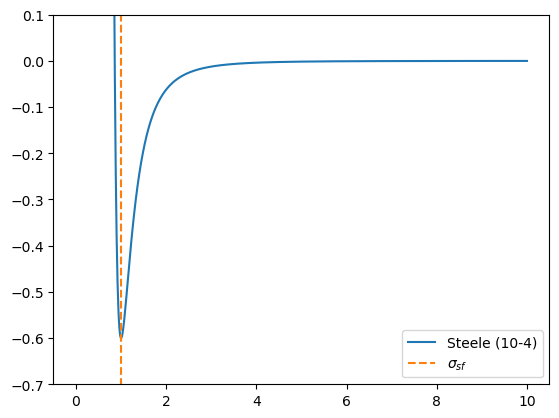

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

dist_vec = np.linspace(0,10,1000)

def Steele_10_4(E_eff,Sigma_sf,dist):
    Phi = np.zeros((len(dist)))
    for i in range(len(dist)):
        if dist[i] != 0:
            Phi[i] =  E_eff*(0.4*(Sigma_sf/dist[i])**10-(Sigma_sf/dist[i])**4)
        elif dist[i] == 0:
            Phi[i] = 1e20
    return Phi

plt.plot(dist_vec,Steele_10_4(1.,1.,dist_vec), label="Steele (10-4)")
plt.plot(np.zeros((1000))+1.,np.linspace(-1,1,1000),linestyle = "--", label = "$\sigma_{sf}$")
#plt.plot(np.linspace(-1,1,1000),np.zeros((1000))-1.,linestyle = ".-", label = "$\sigma_{sf}$")
plt.ylim(-0.7,0.1)
plt.legend()
plt.show()

#### The figure below shows the dependency of the model on $\sigma_{sf}$:

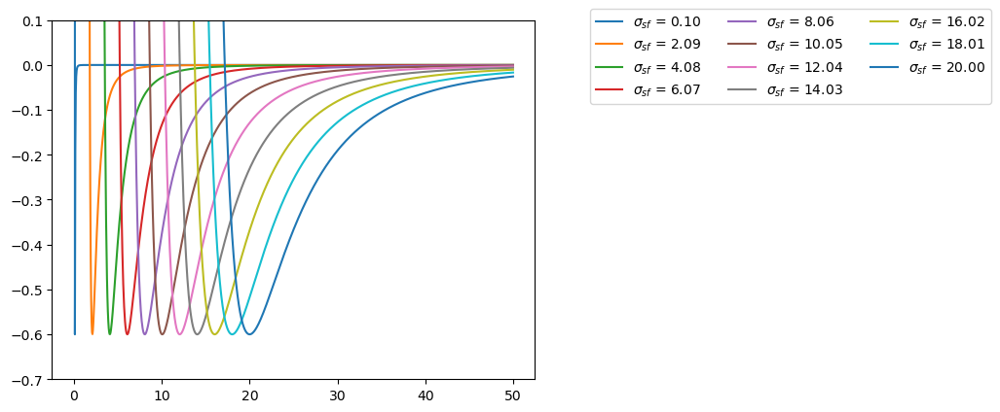

In [ ]:
dist_vec = np.linspace(0,50,1000)

sigma_vec = np.linspace(0.1,20,11)

for i in range(11):
    plt.plot(dist_vec,Steele_10_4(1.,sigma_vec[i],dist_vec), label="$\sigma_{sf}$ = "+str('{:,.2f}'.format(sigma_vec[i])))
plt.ylim(-0.7,0.1)
plt.legend(ncol=3,bbox_to_anchor=(1.1, 1.05))
plt.show()

#### The figure below shows the dependency of the model on $\epsilon_{eff}$:

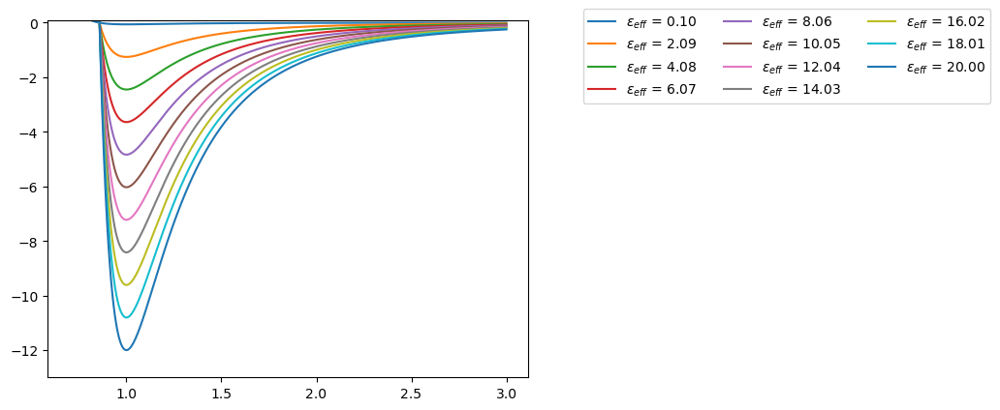

In [ ]:
dist_vec = np.linspace(0.7,3,1000)

eps_vec = np.linspace(0.1,20,11)

for i in range(11):
    plt.plot(dist_vec,Steele_10_4(eps_vec[i],1.,dist_vec), label="$\epsilon_{eff}$ = "+str('{:,.2f}'.format(eps_vec[i])))
plt.ylim(-13,0.1)
plt.legend(ncol=3,bbox_to_anchor=(1.1, 1.05))
plt.show()

#### For this case study, the first step in creating our simulation box is to generate the grid inside the pore. The variables needed to generate the grid are the pore width (H), the number of grid points (N_pnts), and the resolution of our grid (dz). Two of these variables must be set when constructing the simulation box, while the third is obtained from the others. In this way, the user can select H and dz, or N_pnts and H, or N_pnts and dz, and these variables are related as follows:

## $H = N_{pnts} \times dz$

#### in this way:

In [ ]:
import numpy as np
H = 10                                # [Pore width]
dz = 0.1                              # [distance between grid points]
Num_points = int(H/dz)+1              #[Number of points]

#### To build the grid in python we can use the linspace function from the NumPy package

In [ ]:
Z_vec = np.linspace(0,H,Num_points)   #Grid vector

#### Moreover, to check the distribution of the points along the simulation box, we can plot them using Matplotlib's pyplot.

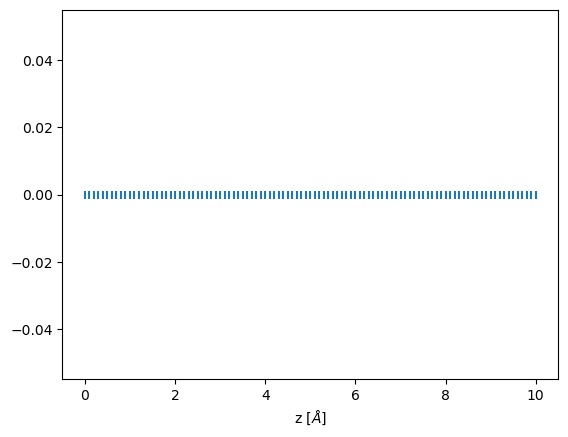

In [ ]:
from matplotlib import pyplot as plt

Y = np.zeros((len(Z_vec)))

plt.scatter(Z_vec,Y, marker = "|")
plt.xlabel("z [$\AA$]")
plt.show()

#### Now that we have the wall potential and the grid representing the positions inside the pore, we can add a wall at the first and last points of the grid to generate the external potential. In this way, the external potential will consider the molecule's interaction with both walls, one of the distinguishing features of cDFT modeling.

#### Then the external potential will be obtained by adding the potentials of the two walls. Considenring that the first wall is positioned in $z = 0$, and the second wall in the position $z = H$, the External potential ($V_{ext}$) can be writed as:

$V_{ext}(z) = \phi_{ext}(z)+\phi_{ext}(H-z)$

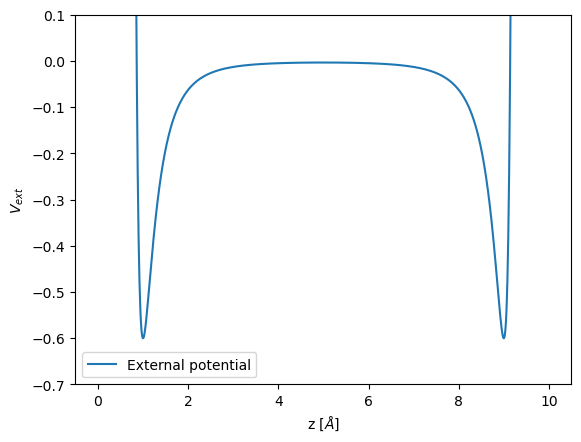

In [ ]:
H = 10
dz = 0.01
nump = int(H/dz)
z_vec = np.linspace(0,H,nump)
Vext = Steele_10_4(1.,1.,z_vec)+Steele_10_4(1.,1.,H-z_vec)


plt.plot(z_vec,Vext, label="External potential")
plt.xlabel("z [$\AA$]")
plt.ylabel("$V_{ext}$")
plt.ylim(-0.7,0.1)
plt.legend()
plt.show()

### Nondimensionalization of inputs

#### Depending on the variables, some can have their numerical values with large orders of magnitude, which can directly affect the convergence of the minimization methods, considering cases in which the excess part of the free energy is essential. To mitigate this, the nondimensionalization of the working variables is a strong suggestion.

#### The following table shows the removal of typical variable units used in the cDFT simulation.

|Variable|Nondimensionalization|Type|
|--|--|--|
|$P^*$|$\frac{P\sigma^3}{\epsilon}$|Pressure|
|$T^*$|$\frac{T}{\epsilon/k_B}$|Temperature|
|$H^*$|$\frac{H}{\sigma}$|Length|
|$\epsilon^*$|$\frac{\epsilon}{\epsilon_{ref}}$|Interaction Potential|
|$\sigma^*$|$\frac{\sigma}{\sigma_{ref}}$|Particle diameter|

###  Ideal gas direct solution

### From the expression of the cDFT model for the ideal gas and the construction of the external potential, the local density for the ideal gas can be obtained directly from the expression:

### $\rho(z) = \rho_{b} \exp \left(- \frac{V_{ext}(z)}{k_BT} \right)$

### Given a condition of the T and P of the volume phase

In [ ]:
P = 1e5   # [Pressure - Pa]
T = 300 # [Temperature - K]

### Given the pore size and simulation boxe

In [ ]:
import numpy as np
H = 30                                # [Pore width - Angstroms]
dz = 0.03                              # [distance between grid points - Angstroms]
Num_points = int(H/dz)+1              #[Number of points]

### Solid-Fluid parameters

In [ ]:
E_eff = 100    #Efective wall parameter [K/Angstrom^2]
Sigma_sf = 2.8 #Solid molecule parameter [Angstrom]

### Removing the dimension of the variables

In [ ]:
# references (Just an example)
Sigma = 3. #Angstrom
Epsilon = 100. #[K]
kb = 1.3806488e-23 #Boltzmann constant


#Nondimensionalization
T = T/Epsilon
P = (P/(kb*Epsilon)*(Sigma*1.e-10)**3)
E_eff = E_eff/Epsilon*(Sigma**2)
Sigma_sf = Sigma_sf/Sigma
H = H/Sigma
dz = dz/Sigma

In [ ]:
E_eff

9.0

### Preparing the grid for the calculation

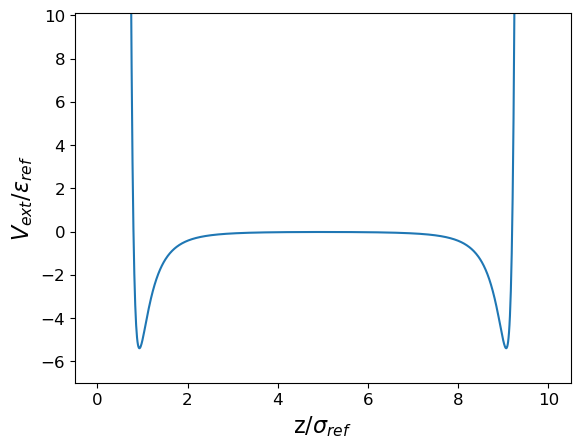

In [ ]:
#Spacial vector
Z_vec = np.linspace(0,H,Num_points)
Vext = Steele_10_4(E_eff,Sigma_sf,Z_vec)+Steele_10_4(E_eff,Sigma_sf,H-Z_vec)
plt.plot(Z_vec,Vext, label="External potential")
plt.xlabel("z/$\sigma_{ref}$",fontsize=16)
plt.ylabel("$V_{ext}/\epsilon_{ref}$",fontsize=16)
plt.ylim(-7,10.1)
#plt.legend()

# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.savefig('HowToDo/Figuras/V_ext.pdf')
plt.show()





### Calculate bulk density

In [ ]:
rho_b = P/T

rho_b

0.0006518674408727258

### And With everything ready, in the case of an ideal gas, the density can be calculated directly:

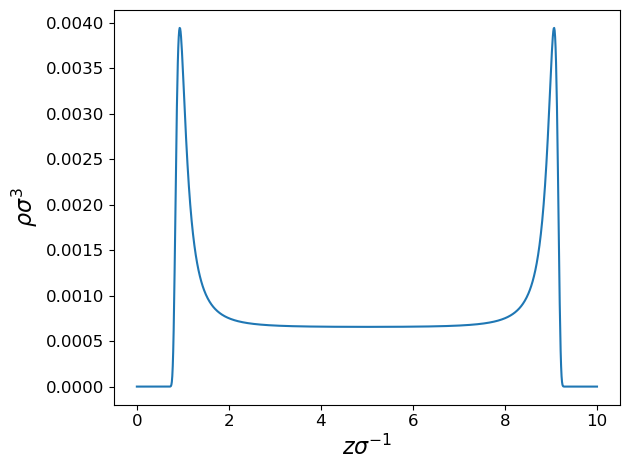

In [ ]:
#Initializing the density vector
rho_vec = rho_b*np.exp(-Vext/T)
plt.plot(Z_vec,rho_vec)
plt.ylabel(r"$\rho \sigma^3$",fontsize=16)
plt.xlabel(r"$z \sigma^{-1}$",fontsize=16)

# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.tight_layout()

plt.savefig('HowToDo/Figuras/Rho_id.pdf')
plt.show()

### From the density profile, it is possible to obtain the amount adsorbed in a slit-like surface:

### $\Gamma \sigma^2 = 0.5\int_0^H \rho(z) dz$

### the excess adsorption isotherm

### $\Gamma_{exc} \sigma^2 = 0.5\int_0^H (\rho(z)-\rho_b) dz$

### The factor 0.5 is due to the division of the amount adsorbed by the two walls, resulting in an amount adsorbed per area.

In [ ]:
from scipy import integrate

Nads = 0.5*integrate.trapz(rho_vec,Z_vec)
Nexc = 0.5*integrate.trapz(rho_vec-rho_b,Z_vec)

### With $\Gamma \sigma^2$ it is possible to built an adsorption isotherm

In [ ]:
import numpy as np

T = 300 #[K]
T = T/Epsilon
P_vec = np.linspace(1e4,40e5,100) #[Pa]
P_vec = ((P_vec)/(kb*Epsilon)*(Sigma*1.e-10)**3) #[Pa]

In [ ]:
T

3.0

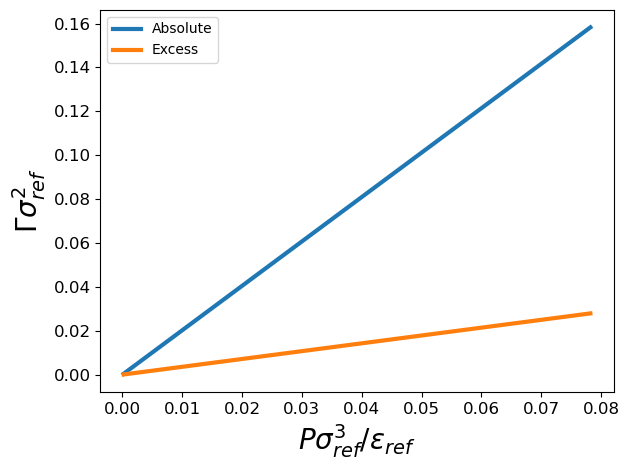

In [ ]:
Nads = np.zeros((len(P_vec)))
Nexc = np.zeros((len(P_vec)))
for i in range(len(P_vec)):
    #Calculating the ideal contribution of the Chemical potential
    rho_homog = P_vec[i]/T
    rho_vec = rho_homog*np.exp(-Vext/T)
    Nads[i] = 0.5*integrate.trapz(rho_vec,Z_vec)
    Nexc[i] = 0.5*integrate.trapz(rho_vec-rho_homog,Z_vec)

#P_vec = np.linspace(0.1,40,100) #[bar]

plt.plot(P_vec,Nads, linewidth=3,label="Absolute")
plt.plot(P_vec,Nexc, linewidth=3,label="Excess")
#plt.xlabel("Pressure [bar]", fontsize=20)
plt.xlabel("$P\sigma_{ref}^3/\epsilon_{ref}$", fontsize=20)
plt.ylabel(r"$\Gamma \sigma_{ref}^2$", fontsize=20)

# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.tight_layout()


plt.legend()
plt.savefig('HowToDo/Figuras/Isotherms_ID.pdf')

plt.show()

### Dependence with the temperature

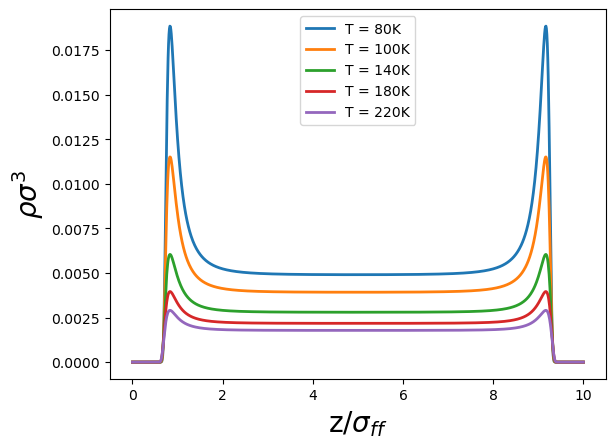

In [ ]:
T_vec = [80,100,140,180,220]
P_vec = 2 #[bar]
P_vec = ((P_vec*1.e5)/(kb*Epsilon)*(Sigma*1.e-10)**3) #[Pa]

E_eff = 20/Epsilon*(Sigma*Sigma) #K/A^2
Sigma_sf = 2.5/Sigma

Vext = Steele_10_4(E_eff,Sigma_sf,Z_vec)+Steele_10_4(E_eff,Sigma_sf,H-Z_vec)

rho_vec_H = np.zeros((len(Vext)))

for j in range(len(T_vec)):
    T_vec[j] = T_vec[j]/Epsilon
    rho_homog = P_vec/T_vec[j]
    #rho_vec = rho_homog*np.exp(-Vext/T_vec[j])
    rho_vec = rho_homog*np.exp(-Vext/T_vec[j])
    rho_vec_H[:] = rho_homog
    T_vec = [80,100,140,180,220]
    plt.plot(Z_vec,rho_vec, linewidth=2,label = "T = "+str('{:,.0f}'.format(T_vec[j]))+"K")
    #plt.plot(Z_vec,rho_vec_H, linewidth=3)
plt.xlabel(r"z/$\sigma_{ff}$", fontsize=20)
plt.ylabel(r"$\rho \sigma^3$", fontsize=20)
plt.legend()
plt.show()

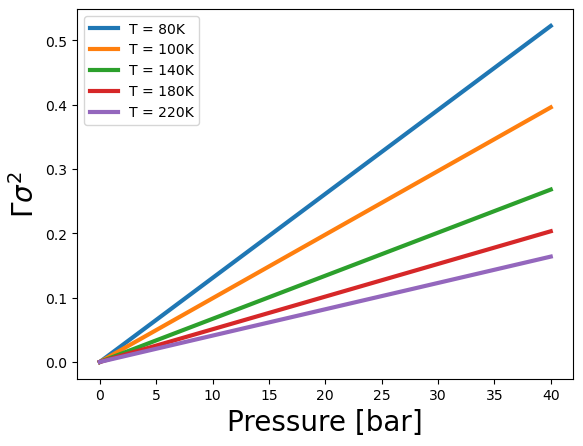

In [ ]:
T_vec = [80,100,140,180,220]
T_vecA = np.zeros((5))
P_vec = np.linspace(0.001,40,100) #[bar]
P_vecA = ((P_vec*1.e5)/(kb*Epsilon)*(Sigma*1.e-10)**3) #[Pa]

for j in range(len(T_vec)):
    T_vecA[j] = T_vec[j]/Epsilon
    rho_vec = np.zeros((len(Vext)))
    Nads = np.zeros((len(P_vec)))
    for i in range(len(P_vec)):
        #Calculating the ideal contribution of the Chemical potential
        rho_homog = P_vecA[i]/T_vecA[j]
        rho_vec = rho_homog*np.exp(-Vext/T_vecA[j])
        Nads[i] = 0.5*integrate.trapz(rho_vec,Z_vec)
    plt.plot(P_vec,Nads, linewidth=3,label = "T = "+str('{:,.0f}'.format(T_vec[j]))+"K")
plt.xlabel("Pressure [bar]", fontsize=20)
plt.ylabel(r"$\Gamma \sigma^2$", fontsize=20)
plt.legend()
plt.show()

## Hard-Sphere Fluid

### With the addition of the hard-sphere term, the cDFT equation must be written in the traditional form, with the contribution of the excess free energy.

## $\rho(r) = \rho_b \exp \left( \frac{\mu_{exc}}{k_BT} - \frac{V_{ext}(r)}{k_BT} - \frac{1}{k_BT}\frac{\delta F_{hs}}{\delta \rho(r)}  \right)$

### The Fundamental Measure Theory

### The excess free energy can be described using the modified fundamental measure theory (FMT) to model the contribution of hard-spheres repulsion.

## $F_{hs} = k_BT\int \Phi^{hs}[n_\alpha(r)] \text{d}r$

### There are some formulations to describe Fhs, which are calculated from some thermodynamic conditions. Yu and Wu separated  into two terms, one considering the contribution of solely scalar terms $\phi_{sc}$ and the other considering vector terms $\phi_{vec}$,

Yu, Yang-Xin, and Jianzhong Wu. "Structures of hard-sphere fluids from a modified fundamental-measure theory." The Journal of chemical physics 117.22 (2002): 10156-10164.

## $\Phi_{hs} = \Phi^{sc}+ \Phi^{vec}$

## $\Phi^{sc} = -n_0 \ln{(1-n_3)}+ \frac{n_1n_2}{1-n_3}+n_2^3 \left( \frac{1}{36\pi(1-n_3)^2}+ \frac{\ln(1-n_3)}{36\pi n_3^2} \right) \\
\Phi^{vec} = -\frac{\textbf{n}_1\textbf{n}_2}{(1-n_3)} - n_2\textbf{n}_2 \cdot \textbf{n}_2 \left( \frac{1}{ 12 \pi(1-n_3)^2} + \frac{\ln (1-n_3)}{12 \pi n_3^2} \right)$

### In which,

## $n_\alpha(r) = \int \rho(r') \omega_\alpha(r-r') dr'$

## where $\alpha = 0, 1, 2, 3, V_1, V_2$ :

## $\omega^{(3)}(r) = \Theta\left(\frac{\sigma}{2}-r\right)\\
\omega^{(2)}(r) = \delta\left(\frac{\sigma}{2}-r\right)\\
\omega^{(V_2)}(r) = \frac{\textbf{r}}{r}\delta\left(\frac{\sigma}{2}-r\right)\\
\omega^{(0)}(r) = \frac{\delta\left(\frac{\sigma}{2}-r\right)}{4\pi R^2} = \frac{\omega^{(2)}(r)}{4\pi R^2}\\
\omega^{(1)}(r) = \frac{\delta\left(\frac{\sigma}{2}-r\right)}{4\pi R} = \frac{\omega^{(2)}(r)}{4\pi R}\\
\omega^{(V_1)}(r) = \frac{\textbf{r}}{r}\frac{\delta\left(\frac{\sigma}{2}-r\right)}{4\pi R} = \frac{\omega^{(V_2)}(r)}{4\pi R}$

### First: Heaviside step function:

$\begin{align}
\Theta(x) = 1& \;, &\text{if}\; &x > 0&\\
             0& \;, &\text{if}\; &x \leq0&.
\end{align}$

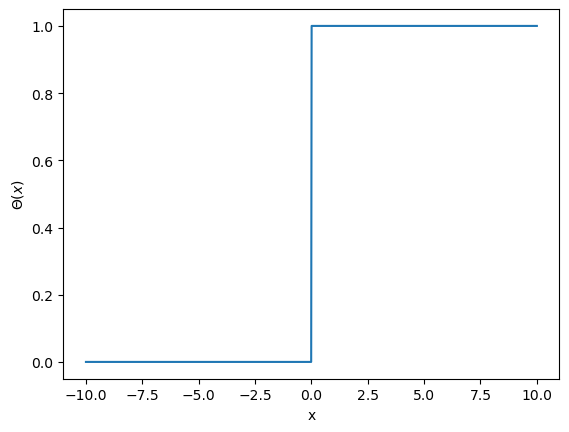

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

x = np.linspace(-10,10,1000)
theta = np.heaviside(x,1)

plt.plot(x,theta)
plt.xlabel("x")
plt.ylabel(r"$\Theta(x)$")
plt.show()

## On the calculation of the weighting functions, the Heaviside function is evaluated concerning $\frac{\sigma}{2}-r$.

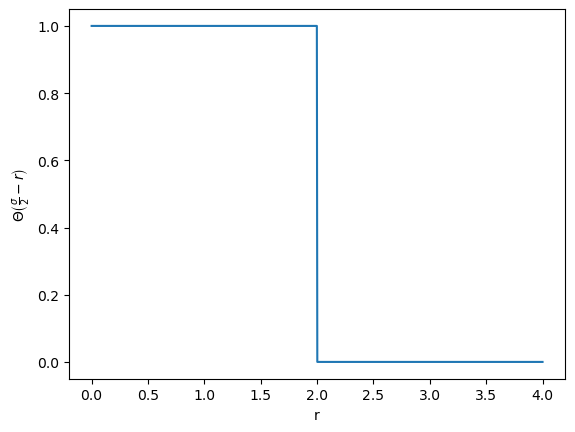

In [ ]:
import numpy as np
from matplotlib import pyplot as plt


#grid points
npoints = 1000

#Molecule radius
Sigma = 4

#space vector
r = np.linspace(0,4,npoints)

#Input of the Heaviside function
x = np.zeros((npoints))
for i in range(1000):
    x[i] = 0.5*Sigma - r[i]

#Heaviside Function
theta = np.heaviside(x,1)


plt.plot(r,theta)
plt.xlabel("r")
plt.ylabel(r"$\Theta\left(\frac{\sigma}{2}-r\right)$")
plt.show()

### Thus the Heaviside function will be 1 for every point inside the molecule radius limits, while it is zero when it is outside the molecule limit.

In [ ]:
import plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
#Jupyter setup
init_notebook_mode(connected=True)
import plotly.graph_objects as go
import numpy as np


Nump = 40 #number point

x = np.linspace(0,10,Nump)
y = np.linspace(0,10,Nump)
z = np.linspace(0,10,Nump)

X,Y,Z = np.meshgrid(x,y,z) # mesh

Raio_esf = 5
center = [5,5,5]
Theta = np.zeros((Nump,Nump,Nump))

for i in range(Nump):
    for j in range(Nump):
        for k in range(Nump):
            dist = np.sqrt((x[i]-center[0])**2+(y[j]-center[1])**2+(z[k]-center[2])**2)
            if Raio_esf-dist > 0:
                Theta[i,j,k] = 1
            else:
                Theta[i,j,k] = 0


fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=Theta.flatten(),
    isomin=0,
    isomax=1,
    opacity=0.1,
    surface_count = 10, #number of isosurfaces, 2 by default(min and max)
    colorbar_nticks=5 # colorbar ticks correspond to isosurface values
    #colorscale='RdBu'
    ))

iplot(fig)

### Whith this example it is possible to see that:
    
$\int \omega^{(3)}\left(\frac{\sigma}{2}-r\right) dr = \int \Theta\left(\frac{\sigma}{2}-r\right) dr = \frac{\pi \sigma^3 }{6}$

In [ ]:
soma = 0
for i in range(Nump):
    for j in range(Nump):
        for k in range(Nump):
            soma += Theta[i,j,k]
soma = soma*(x[1]-x[0])*(y[1]-y[0])*(z[1]-z[0])

In [ ]:
print('Volume of the integrated region =', soma)
print('Volume of the Sphere =', np.pi*10**3/6)

Volume of the integrated region = 522.1935636136818
Volume of the Sphere = 523.5987755982989


### Second: Dirac delta function

$\delta(x) = \frac{\text{d}}{\text{d}x}\Theta(x)$

In [ ]:
def ddx(f,x):
    f_x = np.zeros(len(f))
    for i in range(len(f)):
        h = x[1]-x[0]
        if i>=1 and i<=len(f)-2:
            f_x[i] = (-1*f[i-1]+0*f[i+0]+1*f[i+1])/(2*1.0*h**1)
        else:
            f_x[i] = 0
    return f_x

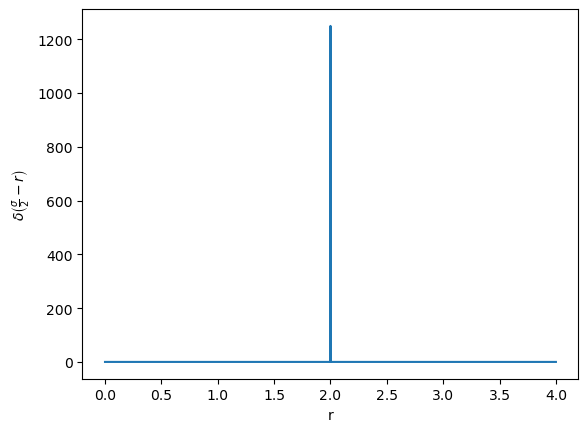

In [ ]:
#grid points
npoints = 10000

#Molecule radius
Sigma = 4

#space vector
r = np.linspace(0,4,npoints)

#Input of the Heaviside function
x = np.zeros((npoints))
for i in range(npoints):
    x[i] = 0.5*Sigma - r[i]

#Heaviside Function
theta = np.heaviside(x,1)

#Dirac Function
Dirac = ddx(theta,x)

plt.plot(r,Dirac)
plt.xlabel("r")
plt.ylabel(r"$\delta\left(\frac{\sigma}{2}-r\right)$")
plt.show()

### What is $\int \delta\left(\frac{\sigma}{2}-r\right)dr$

In [ ]:
from scipy import integrate
print(integrate.trapz(Dirac,r))

1.0000000000002776


### The figure below shows a schematic of how the Dirac delta would look in 3D. To make it easier, where the delta would be different from 0, we have set it to 1.

In [ ]:
import plotly.graph_objects as go
import numpy as np


Nump = 50 #number point

xtop = 11
ytop = 11
ztop = 11

x = np.linspace(0,5.5,Nump)#xtop,Nump)
y = np.linspace(0,5.5,Nump)#ytop,Nump)
z = np.linspace(0,5.5,Nump)#ztop,Nump)

X,Y,Z = np.meshgrid(x,y,z) # mesh

Raio_esf = 5
center = [0.5*xtop,0.5*ytop,0.5*ztop]
Theta = np.zeros((Nump,Nump,Nump))

for i in range(Nump):
    for j in range(Nump):
        for k in range(Nump):
            dist = np.sqrt((x[i]-center[0])**2+(y[j]-center[1])**2+(z[k]-center[2])**2)
            if abs(Raio_esf-dist) < (x[1]-x[0]):
                Theta[i,j,k] = 1
            else:
                Theta[i,j,k] = 0


fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=Theta.flatten(),
    isomin=0,
    isomax=1,
    opacity=0.1,
    surface_count = 10, #number of isosurfaces, 2 by default(min and max)
    colorbar_nticks=2 # colorbar ticks correspond to isosurface values
    #colorscale='RdBu'
    ))

iplot(fig)

## Considering multiple components in a one-dimensional (1D) system, such as the slit-like pore case, the $n_\alpha$ functionals can be rewritten in the form:

## $n_\alpha(r) = \sum_{i}^{N_c} \int\rho(z')\omega_\alpha(z-z') \text{d}z'$

### These weights will then be presented as their respective functions in real space, for the 1D scenario.

# $\omega_0(z-z') = \frac{\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)}{\sigma_i}$

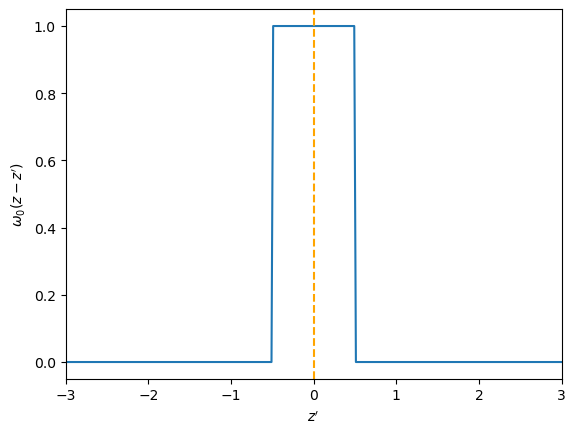

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0


omega0 = (np.heaviside(z-z_line+0.5*sigma,1)-np.heaviside(z-z_line-0.5*sigma,1))/sigma

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_0(z-z')$")
plt.show()

# $\omega_1(z-z') = \frac{\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)}{2}$

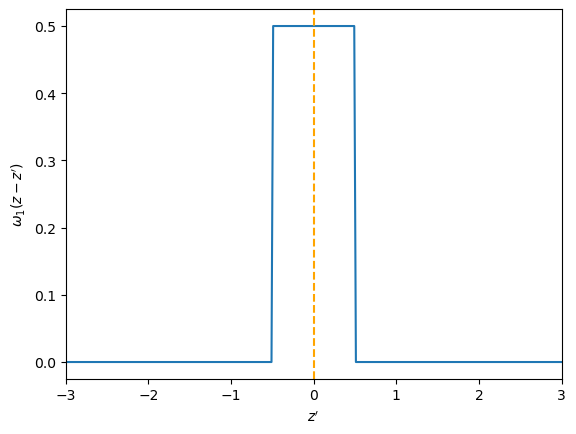

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = (np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))/2

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_1(z-z')$")
plt.show()

# $\omega_2(z-z') = \pi\sigma\left(\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)\right)$

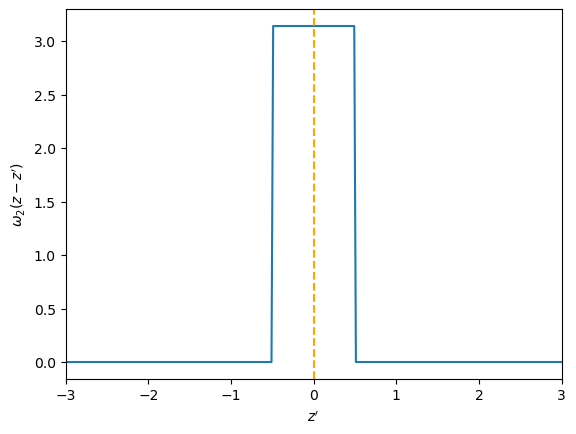

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = (np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*np.pi*sigma

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_2(z-z')$")
plt.show()

# $\omega_3(z-z') = \pi\left(\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)\right)
\times\left[\left(\frac{\sigma}{2} \right)^2 - (z-z')^2\right]$

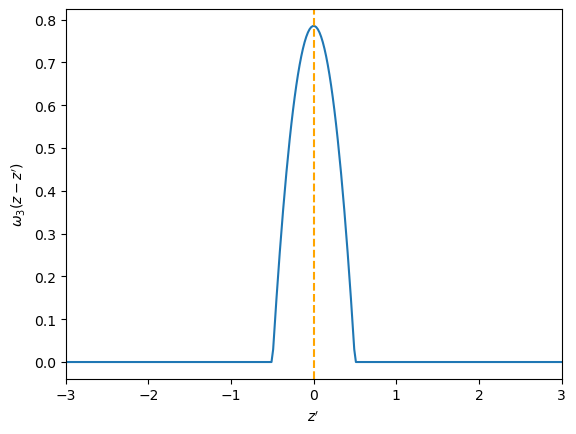

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = (np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*np.pi*((0.5*sigma)**2-(z-z_line)**2)

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_3(z-z')$")
plt.show()

# $\omega_{V1}(z-z') = -\hat{e}_z\frac{\left(\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)\right)}{\sigma}(z-z')$

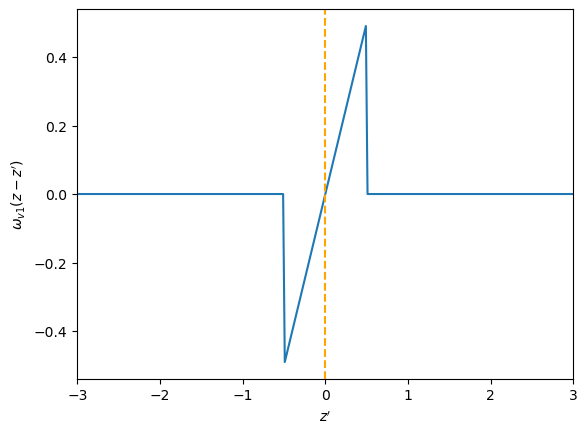

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = -(np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*(z-z_line)/sigma

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_{v1}(z-z')$")
plt.show()

# $\omega_{V2}(z-z') = -2\pi\hat{e}_z\left(\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)\right)(z-z')$

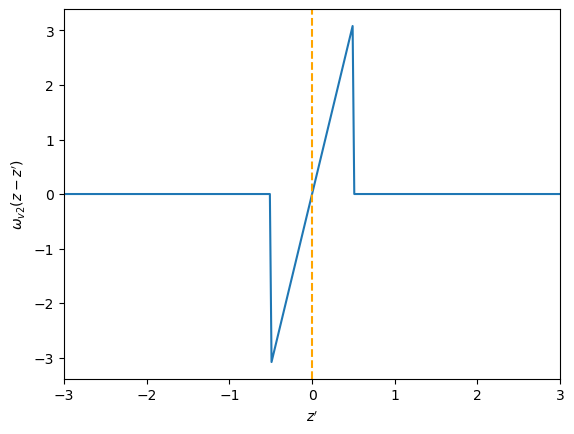

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = -2*np.pi*(np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*(z-z_line)

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_{v2}(z-z')$")
plt.show()

## For the 1D case, the weighted density functions can also be written as ($\hat{z} = z'-z $ )

## $n_0(r) = \sum_{i}^{N_c} \frac{1}{\sigma_i}\int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) d\hat{z}$
## $n_1(r) = \sum_{i}^{N_c} 0.5 \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) d\hat{z}$
## $n_2(r) = \sum_{i}^{N_c} \pi \sigma_i \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) d\hat{z}$
## $n_3(r) = \sum_{i}^{N_c} \pi \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) \left[ \left(\frac{\sigma_i}{2} \right)^2 - \hat{z}^2\right]d\hat{z}$
## $ \textbf{n}_1(r) = - \textbf{e}_z \sum_{i}^{N_c} \frac{1}{\sigma_i} \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) \hat{z}d\hat{z}$
## $ \textbf{n}_2(r) = - \textbf{e}_z \sum_{i}^{N_c} 2\pi \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) \hat{z}d\hat{z}$

## Knowing how to calculate the weighted density functions, it is necessary to solve the functional derivative of the free energy in relation to the particle density:

# $ \frac{\delta F_{hs}}{\delta \rho(\textbf{r})}  =\frac{\delta}{\delta \rho(\textbf{r})}\left( k_BT\int \Phi \left(\textbf{r'}\right)\text{d}\textbf{r'}\right)$

# $ \frac{\delta F_{hs}}{\delta \rho(\textbf{r})}  =\left( k_BT\int \frac{\delta \Phi \left(\textbf{r'}\right)}{\delta \rho(\textbf{r})}\text{d}\textbf{r'}\right)$

# $ \frac{\delta F_{hs}}{\delta \rho(\textbf{r})}  =\left( k_BT\int \sum_\alpha \frac{\partial \Phi (\textbf{r'})}{\partial n_\alpha(\textbf{r'})} \frac{\delta n_\alpha(\textbf{r'})}{\delta \rho(\textbf{r})}\text{d}\textbf{r'}\right)$

### Knowing that

# $\frac{\delta n_\alpha(\textbf{r'})}{\delta \rho(\textbf{r})} = \frac{\delta}{\delta \rho(\textbf{r})}\int \rho(\textbf{r''}) \omega(\textbf{r'}-\textbf{r''})d\textbf{r''}$

# $\frac{\delta n_\alpha(\textbf{r'})}{\delta \rho(\textbf{r})} = \int \delta(\textbf{r''}-\textbf{r}) \omega(\textbf{r'}-\textbf{r''})d\textbf{r''}$

# $\frac{\delta n_\alpha(\textbf{r'})}{\delta \rho(\textbf{r})} = \omega(\textbf{r'}-\textbf{r})$

### The expression $\frac{\delta F_{hs}}{\delta \rho(\textbf{r})}$ can be rewritten as

# $ \frac{\delta F_{hs}}{\delta \rho(\textbf{r})}  =\left( k_BT\int \sum_\alpha \frac{\partial \Phi (\textbf{r'})}{\partial n_\alpha(\textbf{r'})} \omega(\textbf{r}-\textbf{r'})\text{d}\textbf{r'}\right)$

### Therefore, for the scalar weights, as they are even functions

# $\omega(\textbf{r'}-\textbf{r}) = \omega(\textbf{r}-\textbf{r'}) $

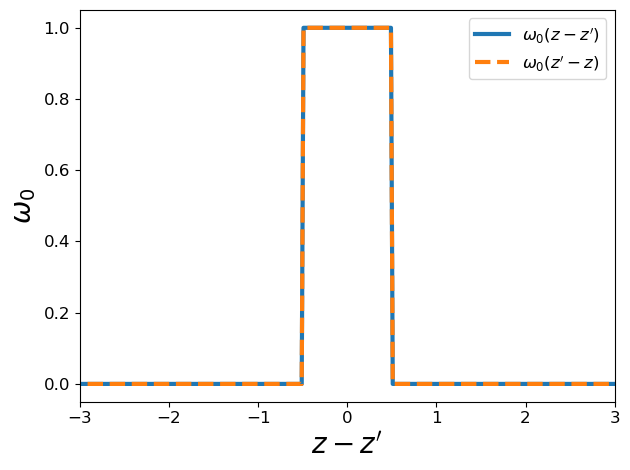

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

u = z-z_line

omega0 = (np.heaviside(z-z_line+0.5*sigma,1)-np.heaviside(z-z_line-0.5*sigma,1))/sigma
omega02 = (np.heaviside(z_line-z+0.5*sigma,1)-np.heaviside(z_line-z-0.5*sigma,1))/sigma

plt.xlim(-3,3)

plt.plot(u,omega0,label ="$\omega_0(z-z')$",linewidth=3)
plt.plot(u,omega02,linestyle="--",label ="$\omega_0(z'-z)$",linewidth=3)

# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)


plt.legend(fontsize=12)
plt.xlabel("$z-z'$", fontsize=20)
plt.ylabel(r"$\omega_0$", fontsize=20)
plt.tight_layout()
plt.savefig('HowToDo/Figuras/w_even.pdf')
plt.show()

### As for the vector weights

# $\omega(\textbf{r'}-\textbf{r}) = -\omega(\textbf{r}-\textbf{r'}) $

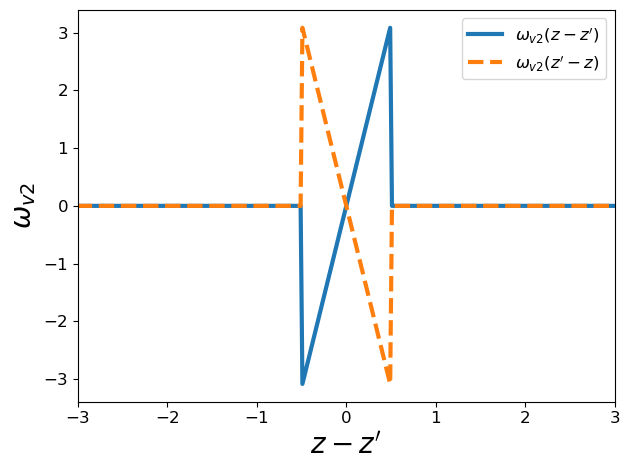

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

u = z-z_line

omega0 = 2*np.pi*(np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*(z-z_line)
omega02 = 2*np.pi*(np.heaviside((z_line)-z+0.5*sigma,1)-np.heaviside((z_line)-z-0.5*sigma,1))*(z_line-z)

plt.xlim(-3,3)

plt.plot(u,omega0,label ="$\omega_{v2}(z-z')$",linewidth=3)
plt.plot(u,omega02,linestyle="--",label ="$\omega_{v2}(z'-z)$",linewidth=3)
# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)


#plt.axvline(x=z,color='orange',linestyle="--",)
plt.legend(fontsize=12)
plt.xlabel("$z-z'$", fontsize=20)
plt.ylabel(r"$\omega_{v2}$", fontsize=20)
plt.tight_layout()
plt.savefig('HowToDo/Figuras/w_odd.pdf')
plt.show()

## Considering the $\Phi_{hs}$ presented above, the partial derivation with respect to all $n_\alpha$ and $n_\alpha$ provides

# $\frac{\partial \Phi}{\partial n_0} = - \ln (1-n_3)$

# $\frac{\partial \Phi}{\partial n_1} = \frac{n_2}{1-n_3}$

# $\frac{\partial \Phi}{\partial n_2} = \frac{n_1}{1-n_3}+3(n_2^2-\textbf{n}_2\cdot\textbf{n}_2)
\times \frac{n_3+(1-n_3)^2\ln(1-n_3)}{36\pi n_3^2(1-n_3)^2}$

# $\frac{\partial \Phi}{\partial n_3} = \frac{n_0}{1-n_3}+\frac{n_1n_2-\textbf{n}_1\cdot\textbf{n}_2}{(1-n_3)^2}-(n_2^3-3n_2\textbf{n}_2\cdot\textbf{n}_2) \times \frac{n_3(n_3^2-5n_3+2)+2(1-n_3)^3\ln(1-n_3)}{36\pi n_3^3(1-n_3)^3}$

# $\frac{\partial \Phi}{\partial \textbf{n}_1} = \frac{\textbf{n}_2}{1-n_3}$

# $\frac{\partial \Phi}{\partial \textbf{n}_2} = -\frac{\textbf{n}_1}{1-n_3}-n_2\textbf{n}_2\frac{n_3+(1-n_3)^2\ln(1-n_3)}{6\pi n_3^2 (1-n_3)^2}$

## After presenting these different terms, we will discuss how to perform the first convolution to calculate $n_\alpha$, and then the second convolution to calculate $\frac{\delta F_{hs}}{\delta \rho(r)}$.

## As previously mentioned, the FMT weights will be used in both convolutions. Another critical point is that these weights are only spatially dependent, so when the size of the simulation box is defined, as well as the spacing between points, these weights can be calculated and saved for future use.

## The following is an example of calculating $\omega_\alpha$ in real space (without periodic condition)

In [ ]:
import numpy as np

# Function to evaluate the Heaviside function for each point of the 1D grid
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*(Z_vec[i]-Z_vec[j])*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

In [ ]:
#%%
#Number of points of the grid
Nump = 500
#Step size on z direction
dz  = 0.01
#Tamanho
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)
# Nondimensionless hard-sphere diameter of the molecule probe
Sigma_ff = 1

In [ ]:
Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)

## The following code allows you to check the format of the $\omega_\alpha$ weights for each position $z$ within the simulation box.

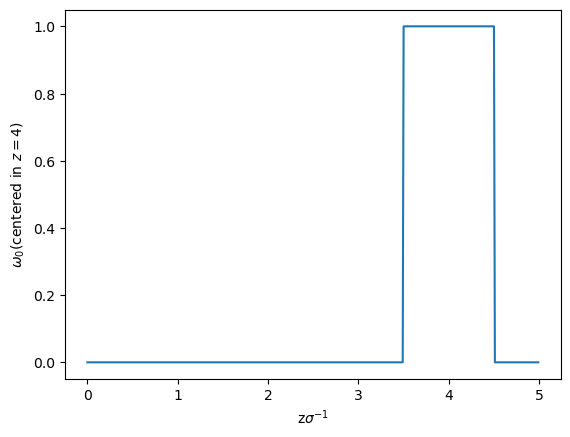

In [ ]:
from matplotlib import pyplot as plt

#Value of Alpha [0,1,2,3,4,5]
# Omega_0 -> 0
# Omega_1 -> 1
# Omega_2 -> 2
# Omega_3 -> 3
# Omega_v1 -> 4
# Omega_v2 -> 5

alpha = 0

#Position of simulation box
z = 4

#point of the position
N_z = int(z/dz)


if (z<H and z>0.0):
    Omega_mid = Omega_vec[:,N_z,int(alpha)]
    plt.plot(Z_vec,Omega_mid)
    plt.xlabel('z$\sigma^{-1}$')
    plt.ylabel('$\omega_'+str(alpha)+'($centered in $ z='+str(z)+')$')
    plt.show()
else:
    print('The value of Z is outside the limit between 0 and '+str(H))


### Let's check the calculation of the weights. The integral of $\omega_3$ evaluated at a point in the simulation box must give the volume of the sphere of diameter $\sigma$.

In [ ]:
#Position of simulation box
z = 1

#point of the position
N_z = int(z/dz)

Omg_test = Omega_vec[:,N_z,3]

import scipy.integrate as integrate

Vol_num = integrate.trapz(Omg_test,Z_vec)

Vol_an = np.pi*Sigma_ff**3/6
Vol_an

print('Numerical volume =',Vol_num)
print('Analytical volume =',Vol_an)

Numerical volume = 0.523546415720739
Analytical volume = 0.5235987755982988


## The following is an example of calculating $\omega_\alpha$ in real space (with periodic condition)

In [ ]:
import numpy as np

# Function to evaluate the Heaviside function for each point of the 1D grid
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            #adding the periodic condition
            elif (H-Z_vec[i]+Z_vec[j]<0.5*Sigma_ff):
                WH[i,j] = 1.
            elif (H+Z_vec[i]-Z_vec[j]<0.5*Sigma_ff):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            if (H-Z_vec[i]+Z_vec[j]<0.5*Sigma_ff):
                    aux = ((0.5*Sigma_ff)**2-(H-Z_vec[i]+Z_vec[j])**2)
                    aux2 = -(H-Z_vec[i]+Z_vec[j])
            elif (H+Z_vec[i]-Z_vec[j]<0.5*Sigma_ff):
                    aux = ((0.5*Sigma_ff)**2-(H+Z_vec[i]-Z_vec[j])**2)
                    aux2 = H+Z_vec[i]-Z_vec[j]
            else:
                    aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
                    aux2 = (Z_vec[i]-Z_vec[j])
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*aux2*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

In [ ]:
#%%
#Number of points of the grid
Nump = 500
#Step size on z direction
dz  = 0.01
#Tamanho
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)
# Nondimensionless hard-sphere diameter of the molecule probe
Sigma_ff = 1

In [ ]:
Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)

## The following code allows you to check the format of the $\omega_\alpha$ weights for each position $z$ within the simulation box.

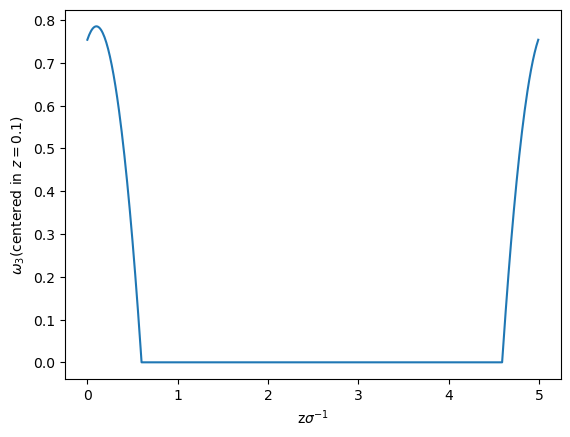

In [ ]:
from matplotlib import pyplot as plt

#Value of Alpha [0,1,2,3,4,5]
# Omega_0 -> 0
# Omega_1 -> 1
# Omega_2 -> 2
# Omega_3 -> 3
# Omega_v1 -> 4
# Omega_v2 -> 5

alpha = 3

#Position of simulation box
z = 0.1

#point of the position
N_z = int(z/dz)


if (z<H and z>0.0):
    Omega_mid = Omega_vec[:,N_z,int(alpha)]
    plt.plot(Z_vec,Omega_mid)
    plt.xlabel('z$\sigma^{-1}$')
    plt.ylabel('$\omega_'+str(alpha)+'($centered in $ z='+str(z)+')$')
    plt.show()
else:
    print('The value of Z is outside the limit between 0 and '+str(H))

# Implementing Convolution

## Convolution in real space

### For the dirac function the rule is:

$ \int_{-\infty}^{\infty} f(x)\delta(x-a)\text{d}x = f(a) $

### Example:

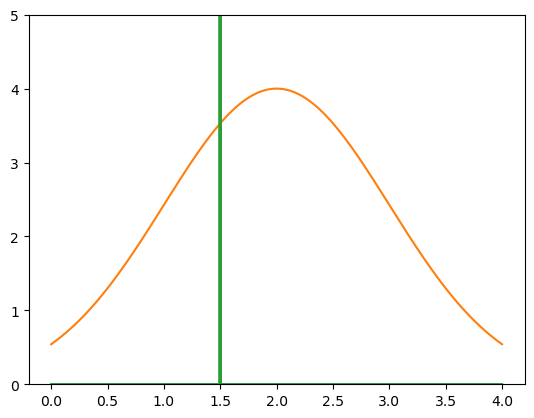

In [ ]:
#grid points
npoints = 1000


x = np.linspace(0,4,npoints)

a = 1.5


#Input of the Heaviside function
y = np.zeros((npoints))
for i in range(npoints):
    y[i] = a - x[i]


#Heaviside Function
theta = np.heaviside(y,1)

#Dirac Function
Dirac = ddx(theta,y)

fx = 4*np.exp(-np.power(x - 2., 2.) / (2 * np.power(1., 2.)))

g = sum(Dirac*fx)*(r[1]-r[0])

func_g = Dirac*fx

plt.plot(x,Dirac)
plt.plot(x,fx)
plt.plot(x,func_g)
plt.ylim(0,5)
plt.show()

In [ ]:
print('value of the integral =',g)
print('f(a) =',4*np.exp(-np.power(a - 2., 2.) / (2 * np.power(1., 2.))))

value of the integral = 0.35259220914552347
f(a) = 3.529987610338382


### Implementing Convolution for the Heaviside step

$(f \circledast \Theta)(t) = \int_{-\infty}^{\infty}f(\tau)\Theta(t-\tau)\text{d}\tau$

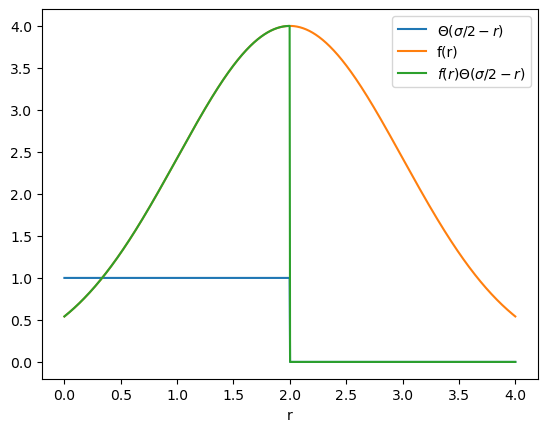

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from scipy import integrate

#grid points
npoints = 1000

#Molecule radius
Sigma = 4

#space vector
r = np.linspace(0,4,npoints)

#Input of the Heaviside function
x = np.zeros((npoints))
for i in range(npoints):
    x[i] = 0.5*Sigma - r[i]


#Heaviside Function
theta = np.heaviside(x,1)

#density
f = 4*np.exp(-np.power(r - 2., 2.) / (2 * np.power(1., 2.)))

func_g = theta*f

plt.plot(r,theta,label='$\Theta(\sigma/2-r)$')
plt.plot(r,f,label='f(r)')
plt.plot(r,func_g,label='$f(r)\Theta(\sigma/2-r)$')
plt.xlabel("r")
plt.legend()
plt.show()

In [ ]:
integrate.trapz(theta*f,r), integrate.trapz(func_g,r)

(4.7851506068229765, 4.7851506068229765)

## Calculation of $\frac{\delta F_{hs}}{\delta \rho(\textbf{r})}$ from FMT convolutions in real space

### To calculate the weights, it is important to define the conditions of the simulation box

In [ ]:
#%%
#Number of points of the grid
Nump = 500
#Step size on z direction
dz  = 0.01
#Simulation box width (1D)
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)
# Nondimensionless hard-sphere diameter of the molecule probe
Sigma_ff = 1

### The first step is to define the functions for calculating the weights in real space. In this example, we will use weights without a periodic boundary condition.

### In this way we can make the weights ready for use from the expression below

In [ ]:
import numpy as np

# Function to evaluate the Heaviside function for each point of the 1D grid
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*(Z_vec[i]-Z_vec[j])*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

In [ ]:
Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)

### With the weights, we can define a function to calculate each $n_{\alpha}$ for each point on our grid. This is the first convolution to be solved:

### $n_{\alpha}(z) = \int \rho(z')\omega(z-z')dz'$

In [ ]:
def calc_N(H,Omega_vec,density,Nump,dz,Sigma_ff,Z_vec):
    N_alpha = np.zeros((Nump,6))
    conv = np.zeros((Nump,6))
    for n in range(6):
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*density[i]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*density[i]
    N_alpha = conv*dz
    return N_alpha

### Here

### $n_{0}$ -> N_alpha[:,0]
### $n_{1}$ -> N_alpha[:,1]
### $n_{2}$ -> N_alpha[:,2]
### $n_{3}$ -> N_alpha[:,3]
### $n_{v1}$ -> N_alpha[:,4]
### $n_{v2}$ -> N_alpha[:,5]

### With the values of $n_{\alpha}$ we can calculate the $\frac{\partial \phi_{hs}(r)}{\partial n_\alpha(r)}$:

In [ ]:
def d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec):
    N_fmt = calc_N(H,Omega_vec,rho_vec,Nump,dz,Sigma_ff,Z_vec)
    dPhi = np.zeros((Nump,6))
    for i in range(Nump):
        if N_fmt[i,3]> 1.e-8:
            Temp = 1.-N_fmt[i,3]
            dPhi[i,0] = -np.log(Temp)
            dPhi[i,1] = N_fmt[i,2]/Temp
            dPhi[i,2] = (N_fmt[i,1]/Temp)+(np.log(Temp)/N_fmt[i,3]+
                        1.0/Temp**2)*(N_fmt[i,2]**2-
                        N_fmt[i,5]**2)/(12.0*np.pi*N_fmt[i,3])
            dPhi[i,3] = N_fmt[i,0]/Temp+(N_fmt[i,1]*N_fmt[i,2]-N_fmt[i,4]*
                    N_fmt[i,5])/Temp**2-(np.log(Temp)/(18.0*np.pi*
                    N_fmt[i,3]**3)+1.0/(36.0*np.pi*N_fmt[i,3]**2*Temp)+
                    (1.0-3.0*N_fmt[i,3])/(36.0*np.pi*N_fmt[i,3]**2*
                    Temp**3))*(N_fmt[i,2]**3-3.0*N_fmt[i,2]*N_fmt[i,5]**2)
            dPhi[i,4] = -N_fmt[i,5]/Temp
            dPhi[i,5] = -N_fmt[i,4]/Temp-(np.log(Temp)/N_fmt[i,3]+1.0
                    /Temp**2)*N_fmt[i,2]*N_fmt[i,5]/(6.0*np.pi*N_fmt[i,3])
    return dPhi

### And with the values of $\frac{\partial \phi_{hs}(r)}{\partial n_\alpha(r)}$ we can calculate the second convolution:

## $\frac{\delta F_{hs}[\rho(\textbf{z})]}{\delta \rho(\textbf{z})} = \int \frac{\partial \phi(\textbf{z'})}{\partial n_\alpha (\textbf{z'})} \omega(z-z')dz'$

In [ ]:
def calc_dFHS(H,Omega_vec,rho_vec,Nump,dz,T,Sigma_ff,Z_vec):
    dPhi = d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec)
    conv = np.zeros((Nump,6))
    FHS = np.zeros((Nump))
    for n in range(6):
        if n == 4 or n == 5:
            Omega_vec[:,:,n] *= -1
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*dPhi[i,n]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*dPhi[i,n]
    for i in range(Nump):
        FHS[i] = np.sum(conv[i,:])*dz
    return FHS*T

### The value for the derivative of the free energy can be validated by the value of the chemical potential when we look at a point in the middle of a large simulation box.

In [ ]:
rho_H = 0.5

EtaH = np.pi*rho_H*Sigma_ff**3/6.0

mu_HS = T*(EtaH*(8.0-9.0*EtaH+3.*EtaH**2)/(1.-EtaH)**3)

print(mu_HS)

11.420356269613952


In [ ]:
rho_vec = np.zeros((Nump))+rho_H

dFhs = calc_dFHS(H, Omega_vec, rho_vec, Nump, dz, T, Sigma_ff, Z_vec)

print(dFhs[int(Nump/2)])

11.419516554464387


### This code can be accelerated with JIT (Just in Time) from the Numba toolbox, optimizing the loops.

In [ ]:
#%%
#Number of points of the grid
Nump = 500
#Step size on z direction
dz  = 0.01
#Simulation box width (1D)
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)
# Nondimensionless hard-sphere diameter of the molecule probe
Sigma_ff = 1

import numpy as np
from numba import jit


# Function to evaluate the Heaviside function for each point of the 1D grid
@jit(nopython=True)
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
@jit(nopython=True)
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*(Z_vec[i]-Z_vec[j])*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

@jit(nopython=True)
def calc_N(H,Omega_vec,density,Nump,dz,Sigma_ff,Z_vec):
    N_alpha = np.zeros((Nump,6))
    conv = np.zeros((Nump,6))
    for n in range(6):
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*density[i]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*density[i]
    N_alpha = conv*dz
    return N_alpha

@jit(nopython=True)
def d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec):
    N_fmt = calc_N(H,Omega_vec,rho_vec,Nump,dz,Sigma_ff,Z_vec)
    dPhi = np.zeros((Nump,6))
    for i in range(Nump):
        if N_fmt[i,3]> 1.e-8:
            Temp = 1.-N_fmt[i,3]
            dPhi[i,0] = -np.log(Temp)
            dPhi[i,1] = N_fmt[i,2]/Temp
            dPhi[i,2] = (N_fmt[i,1]/Temp)+(np.log(Temp)/N_fmt[i,3]+
                        1.0/Temp**2)*(N_fmt[i,2]**2-
                        N_fmt[i,5]**2)/(12.0*np.pi*N_fmt[i,3])
            dPhi[i,3] = N_fmt[i,0]/Temp+(N_fmt[i,1]*N_fmt[i,2]-N_fmt[i,4]*
                    N_fmt[i,5])/Temp**2-(np.log(Temp)/(18.0*np.pi*
                    N_fmt[i,3]**3)+1.0/(36.0*np.pi*N_fmt[i,3]**2*Temp)+
                    (1.0-3.0*N_fmt[i,3])/(36.0*np.pi*N_fmt[i,3]**2*
                    Temp**3))*(N_fmt[i,2]**3-3.0*N_fmt[i,2]*N_fmt[i,5]**2)
            dPhi[i,4] = -N_fmt[i,5]/Temp
            dPhi[i,5] = -N_fmt[i,4]/Temp-(np.log(Temp)/N_fmt[i,3]+1.0
                    /Temp**2)*N_fmt[i,2]*N_fmt[i,5]/(6.0*np.pi*N_fmt[i,3])
    return dPhi


@jit(nopython=True)
def calc_dFHS(H,Omega_vec,rho_vec,Nump,dz,T,Sigma_ff,Z_vec):
    dPhi = d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec)
    conv = np.zeros((Nump,6))
    FHS = np.zeros((Nump))
    for n in range(6):
        if n == 4 or n == 5:
            Omega_vec[:,:,n] *= -1
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*dPhi[i,n]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*dPhi[i,n]
    for i in range(Nump):
        FHS[i] = np.sum(conv[i,:])*dz
    return FHS*T


Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)
dFhs = calc_dFHS(H, Omega_vec, rho_vec, Nump, dz, T, Sigma_ff, Z_vec)

print(dFhs[int(Nump/2)])

11.419516554464387


# Convolução no espaço de Fourier

### To solve the FMT convolution in Fourier space, the first step is to take the variables into Fourier space. This procedure can be done analytically or using the FFT strategy.

### We can use several libraries in Python to perform the FFT conversion; in this review, we will present one of them. However, it is preferable to transform the weights analytically into fourier space for two reasons. The first is to reduce the number of operations within the loop in which the DFT is converged. The second reason is the noise associated with the FFT transformation, which, when applied to both the weights and the other variables, which have no analytical solution, forces the user to use a very refined mesh to find a more accurate convolution value.

### Therefore, in the literature, the suggestion is to use the weights in Fourier space analytically, which will be presented now.


### There are different ways to define the Fourier transform, a more generic way to present this transformation is in the following equation:

## $\sqrt{\frac{|b|}{(2 \pi )^{1-a}}}\int_{-\infty}^{\infty}f(t)e^{i b k t}\text{d}t$

### $a$ and $b$ are parameters that can take on different values depending on the definition. Some commonly used examples are

### $(a,b)$ = $(0,1)$,$(1,-1)$,$(-1,1)$ and $(0,-2\pi)$

### Here, we will use $(0,-2\pi)$ since, by default, it is used in the packages that will be presented.

### With these values, the transformation will be:

## $\int_{-\infty}^{\infty}f(t)e^{-2 \pi i k t}\text{d}t$

### To get the FMT weights for our one-dimensional problem, we apply this operator to the weights $\omega_{\alpha}(z-z')$.

### If $u = z - z'$

### For the $\omega_0(u)$:

## $\int_{-\infty}^{\infty}\frac{\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)}{\sigma_i}e^{-2 \pi i k u}\text{d}u = \frac{\sin(\sigma k \pi)}{\sigma k \pi}$

### and with

### $\lim_{k \to 0} \frac{\sin(\sigma k \pi)}{\sigma k \pi} = 1$

### For the $\omega_1(u)$:

## $\int_{-\infty}^{\infty}\frac{\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)}{2}e^{-2 \pi i k u}\text{d}u = \frac{\sin(\sigma k \pi)}{2 k \pi}$

### and with

### $\lim_{k \to 0} \frac{\sin(\sigma k \pi)}{(2 k \pi)} = 0.5 \sigma$

### For the $\omega_2(u)$:

## $\int_{-\infty}^{\infty}\pi\sigma\left(\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)\right) e^{-2 \pi i k u}\text{d}u = \frac{\sigma \sin(\sigma k \pi)}{k}$

### and with

### $\lim_{k \to 0} \frac{\sigma \sin(\sigma k \pi)}{k} = \pi \sigma^2$

### For the $\omega_3(u)$:

## $\int_{-\infty}^{\infty} \pi\left(\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)\right)
\times\left[\left(\frac{\sigma}{2} \right)^2 - (u)^2\right] e^{-2 \pi i k u}\text{d}u = $
## $\frac{\sin(\sigma k \pi)}{2 k^3 \pi^2}-\frac{\sigma \cos(\sigma k \pi)}{2 k^2 \pi}$

### and with:

### $\lim_{k\to 0}\frac{\sin(\sigma k \pi)}{2 k^3 \pi^2}-\frac{\sigma \cos(\sigma k \pi)}{2 k^2 \pi} = \frac{\pi \sigma^3}{6}$

### For the $\omega_{v1}(u)$:

## $\int_{-\infty}^{\infty} u \hat{e}_u\frac{\left(\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)\right)}{\sigma}  e^{-2 \pi i k u}\text{d}u = -\frac{i \left(\sin(\sigma k \pi)-\sigma k \pi\cos(\sigma k \pi) \right)}{2 \sigma k^2 \pi^2}$

### and with:

### $\lim_{k\to 0}\frac{i \left(\sin(\sigma k \pi)-\sigma k \pi\cos(\sigma k \pi) \right)}{2 \sigma k^2 \pi^2}=0 $

### For the $\omega_{v2}(u)$:

## $\int_{-\infty}^{\infty} 2 \pi u \hat{e}_u \left(\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)\right)  e^{-2 \pi i k u}\text{d}u = -\frac{i \left(\sin(\sigma k \pi)-\sigma k \pi\cos(\sigma k \pi) \right)}{k^2 \pi}$

### and with:

### $\lim_{k\to 0}\frac{i \left(\sin(\sigma k \pi)-\sigma k \pi\cos(\sigma k \pi) \right)}{k^2 \pi}=0 $

### As with real-space weights, you can define a function for the weights so that they are calculated at the beginning of the algorithm and saved and reused during the DFT convergence process.

### The following is an example function for calculating weights in Fourier space:

In [ ]:
def W_FMT_calc(H,Nump,dhs):

    #kf is the Discrete Fourier Transform sample frequencies
    kf = np.fft.fftfreq(Nump,d=H/(Nump-1))
    #Hard sphere Radius
    rhs = 0.5*dhs
    #Weights of the FMT
    w_fmt = np.zeros((Nump,6),dtype=np.complex128)

    for i in range(Nump):
        if (i>0):
            w_fmt[i,0] = 2.0*rhs*np.sin(2.0*np.pi*rhs*kf[i])/(kf[i]*4.*np.pi*rhs**2)
            w_fmt[i,1] = 2.0*rhs*np.sin(2.0*np.pi*rhs*kf[i])/(kf[i]*4.*np.pi*rhs)
            w_fmt[i,2] = 2.0*rhs*np.sin(2.0*np.pi*rhs*kf[i])/kf[i]
            w_fmt[i,3] = (np.sin(2.0*rhs*kf[i]*np.pi)-
                        2.0*rhs*np.pi*kf[i]*np.cos(2.0*rhs*kf[i]*np.pi))/(2.*kf[i]**3*np.pi**2)
            w_fmt[i,4] = -(-2j*rhs*kf[i]*np.pi*np.cos(2*rhs*kf[i]*np.pi) +
                          1j*np.sin(2*rhs*kf[i]*np.pi))/(np.pi*kf[i]**2)/(4.*np.pi*rhs)
            w_fmt[i,5] = -(-2j*rhs*kf[i]*np.pi*np.cos(2*rhs*kf[i]*np.pi) +
                          1j*np.sin(2*rhs*kf[i]*np.pi))/(np.pi*kf[i]**2)
        else:
            w_fmt[i,0] = 1.0
            w_fmt[i,1] = rhs
            w_fmt[i,2] = 4.0*rhs**2*np.pi
            w_fmt[i,3] = 4.0*np.pi*rhs**3/3.0
            w_fmt[i,4] = 0.0
            w_fmt[i,5] = 0.0

    return w_fmt

### Here the inputs are $H$, $Nump$, $dhs$ which represent the size of the box, the hard-sphere diameter

### Validation of $\omega_3$. Bringing back to real space.

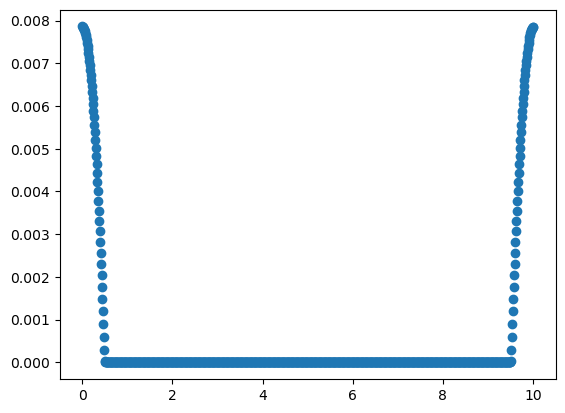

In [ ]:
H = 10
Nump = 1000
dhs = 1.0

z = np.linspace(0,H,Nump)

w_fmt = W_FMT_calc(H,Nump,dhs)

w3 = w_fmt[:,3]

rho_teste = np.zeros((int(Nump)))+1.0

from scipy.fft import fft, ifft

rho_fft = fft(rho_teste)

Conv_test_F = ifft(rho_fft*w3)

result_convolution =  np.real(Conv_test_F)


WFMTreal = np.real(ifft(w3))

from matplotlib import pyplot as plt
plt.scatter(z,WFMTreal)
#plt.xlim(0,10)
plt.show()


### Having the weights in Fourier space, it's possible to calculate the $n_\alpha$'s. To transform the density vector $\rho$ into Fourier space, one can use the fft functions from the scipy.fft package. Similarly, to obtain the inverse transform, the ifft function from the same package can be employed.

### Below is a routine that takes the weight vector (w\_fmt) already in Fourier space, converts the density vectors to Fourier space, and performs the multiplication. Finally, the $n_\alpha$'s are converted back to real space.

In [ ]:

#Importing FFT and Inverse FFT functions
from scipy.fft import fft, ifft
#Importing FFT and Inverse FFT functions
def calc_N(w_fmt, rho, Nump):
    rho_fft = fft(rho)

    N_fft = np.zeros((Nump, 6), dtype=np.complex128)
    N_real = np.zeros((Nump, 6))

    for i in range(6):
        N_fft[:, i] = w_fmt[:, i]*rho_fft

    for i in range(6):
        N_real[:, i] = ifft(N_fft[:, i]).real

    return N_real


### With the $n_\alpha$'s in real space, the calculation of $\partial \phi / \partial n_\alpha$ can be done the same way as presented in the previous section.
### Thus, to complete the calculation of $\delta F_{hs}/ \delta \rho$, $\partial \phi / \partial n_\alpha$ is converted to Fourier space and multiplied by the weight vector already in Fourier space, as shown in the following code.

In [ ]:
def calc_dFHS(H,w_fmt,rho_vec,Nump):
    dPhi = d_Phi(H,w_fmt,Nump,rho_vec)

    dPhi_fft = np.zeros((Nump,6),dtype=complex)
    dFHS_fft = np.zeros((Nump,6),dtype=complex)
    dFHS_real = np.zeros((Nump,6))


    for i in range(6):
        dPhi_fft[:,i] = fft(dPhi[:,i])
        if i == 4 or i == 5:
            w_fmt[:,i] *= -1
        dFHS_fft[:,i] = w_fmt[:,i]*dPhi_fft[:,i]
        dFHS_real[:,i] =  np.real(np.fft.ifftn(dFHS_fft[:,i]))

    dFHS = np.zeros((Nump))

    for i in range(Nump):
        dFHS[i] = np.sum(dFHS_real[i,:])

    return dFHS

### Where dPhi represents $\partial \phi / \partial n_\alpha$, dPhi\_fft is its value in Fourier space, dFHS\_fft is $\delta F_{hs}/ \delta \rho$ in Fourier space, while dFHS\_real is its value back in real space. With these values, performing the iterative method presented below is possible.

# Now we can rewrite the DFT algorithm now accounting for the Hard-Spheres contribution

### First, calculate the bulk density considering P and T in volume and some properties of the molecules

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from scipy.optimize import minimize
from numba import jit

#Temperature of the system [K]
T = 100
#Volumar Pressure [Bar]
P = 11
#LJ Properties of the molecule probe
Sigma_ff = 3 #A
d_HS = Sigma_ff
Eps_kb = 100 #K
#LJ Properties of the wall
E_eff = 100
Sigma_sf = 2.5
#Boltzmann constant
kb = 1.3806488e-23

#Normalization
T = T/Eps_kb
P = ((P*1.e5)/(kb*E_eff)*(Sigma_ff*1.e-10)**3)
E_eff = E_eff/Eps_kb*(Sigma_ff*Sigma_ff)
Eps_kb = Eps_kb/Eps_kb
d_HS = d_HS/Sigma_ff
Sigma_sf = Sigma_sf/Sigma_ff
Sigma_ff = Sigma_ff/Sigma_ff
rc_MF = 5.*Sigma_ff

#Number of points of the grid
H = 5                                # [Pore width - Angstroms]
dz = 0.01                              # [distance between grid points - Angstroms]
Nump = int(H/dz)+1              #[Number of points]
#Step size on z direction
#Spacial vector
Z_vec = np.linspace(0,H,Nump)

#Calculating Rho_H

def Fobj_Rho(rho0):
    #Initial guess
    Eta = np.pi*rho0*Sigma_ff**3/6.
    #Carnahan–Starling equation of state
    P_cs = T*rho0*(1+Eta+Eta**2-Eta**3)/(1-Eta)**3
    return (P_cs-P)**2

min_val = minimize(Fobj_Rho, 1.e-7, method='BFGS')

rho_H = min_val.x
print(rho_H)

[0.02059827]


### Calculate the volumetric chemical potential

In [ ]:
#Chemical-Potential calculation

#Ideal-Gas contribution
mu_ID = T*np.log(rho_H)

EtaH = np.pi*rho_H*Sigma_ff**3/6.0

mu_HS = T*(EtaH*(8.0-9.0*EtaH+3.*EtaH**2)/(1.-EtaH)**3)

mu_H = mu_ID+mu_HS

print(mu_H)

[-3.79449116]


### Adding external potential

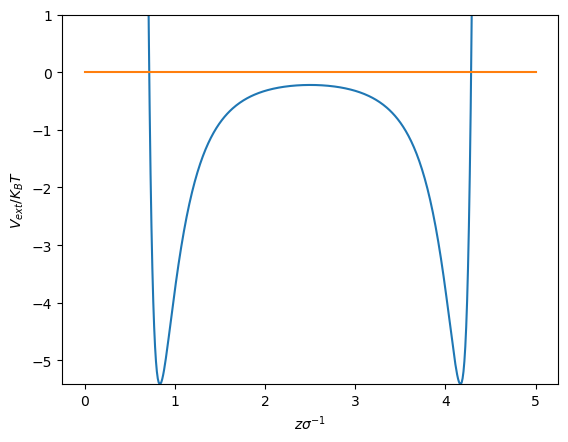

In [ ]:
#External Potentiel Calculation
def Phi_ext(E_eff,Sigma_sf,dist):
    if dist != 0:
        return E_eff*(0.4*(Sigma_sf/dist)**10-(Sigma_sf/dist)**4)
    elif dist == 0:
        return 1e200

Vext_vec = np.zeros(Nump)

for i in range(Nump):
    Vext_vec[i] = T*Phi_ext(E_eff,Sigma_sf,Z_vec[i]) + \
                  T*Phi_ext(E_eff,Sigma_sf,H-Z_vec[i])

plt.plot(Z_vec,Vext_vec)
plt.plot(Z_vec,np.zeros((Nump)))
plt.ylabel("$V_{ext}/K_BT$")
plt.xlabel("$z \sigma^{-1}$")
plt.ylim(np.min(Vext_vec),1)
plt.show()

### Defining the FMT functions and calculating the weights $\omega(z-z')$

In [ ]:
# Function to evaluate the Heaviside function for each point of the 1D grid
@jit(nopython=True)
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
@jit(nopython=True)
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*(Z_vec[i]-Z_vec[j])*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

@jit(nopython=True)
def calc_N(H,Omega_vec,density,Nump,dz,Sigma_ff,Z_vec):
    N_alpha = np.zeros((Nump,6))
    conv = np.zeros((Nump,6))
    for n in range(6):
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*density[i]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*density[i]
    N_alpha = conv*dz
    return N_alpha

@jit(nopython=True)
def d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec):
    N_fmt = calc_N(H,Omega_vec,rho_vec,Nump,dz,Sigma_ff,Z_vec)
    dPhi = np.zeros((Nump,6))
    for i in range(Nump):
        if N_fmt[i,3]> 1.e-8:
            Temp = 1.-N_fmt[i,3]
            dPhi[i,0] = -np.log(Temp)
            dPhi[i,1] = N_fmt[i,2]/Temp
            dPhi[i,2] = (N_fmt[i,1]/Temp)+(np.log(Temp)/N_fmt[i,3]+
                        1.0/Temp**2)*(N_fmt[i,2]**2-
                        N_fmt[i,5]**2)/(12.0*np.pi*N_fmt[i,3])
            dPhi[i,3] = N_fmt[i,0]/Temp+(N_fmt[i,1]*N_fmt[i,2]-N_fmt[i,4]*
                    N_fmt[i,5])/Temp**2-(np.log(Temp)/(18.0*np.pi*
                    N_fmt[i,3]**3)+1.0/(36.0*np.pi*N_fmt[i,3]**2*Temp)+
                    (1.0-3.0*N_fmt[i,3])/(36.0*np.pi*N_fmt[i,3]**2*
                    Temp**3))*(N_fmt[i,2]**3-3.0*N_fmt[i,2]*N_fmt[i,5]**2)
            dPhi[i,4] = -N_fmt[i,5]/Temp
            dPhi[i,5] = -N_fmt[i,4]/Temp-(np.log(Temp)/N_fmt[i,3]+1.0
                    /Temp**2)*N_fmt[i,2]*N_fmt[i,5]/(6.0*np.pi*N_fmt[i,3])
    return dPhi


@jit(nopython=True)
def calc_dFHS(H,Omega_vec,rho_vec,Nump,dz,T,Sigma_ff,Z_vec):
    dPhi = d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec)
    conv = np.zeros((Nump,6))
    FHS = np.zeros((Nump))
    for n in range(6):
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*dPhi[i,n]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*dPhi[i,n]
    for i in range(Nump):
        FHS[i] = np.sum(conv[i,:])*dz
    return FHS*T


Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)

### Picard Method

#### Unlike the ideal gas case, when the residual contributions model the free energy of the fluid, it is no longer possible to get the result directly. It is, therefore, necessary to use a numerical methodology to obtain the solution. The most traditional method for solving this system is the Picard method.

#### $\rho_{new}(r) = exp \left(\beta \mu_b-\beta V_{ext}(r)-\frac{\delta F_{res}}{\delta \rho(r)} \right) $
#### $\rho_{k+1}(r) = (1-\alpha)\rho_{new}(r) + \alpha\rho_{k}(r)$

#### Where alpha is a parameter that dampens the value of $rho_{k+1}(r)$, making it difficult for the new values to make the local packing non-physical, meaning that $n_3(r)$ could be greater than 1, preventing the method from converging. The following is a routine in which the Picard method is used.

### The most classic, robust and easiest way to implement DFT is to solve the Euler-Lagrange equation equation using Picard's method. The Picard method consists of successive substitutions, using a mixing parameter introduced to prevent the method from diverging.

### This parameter becomes essential for this methodology because, given the possibility of a substantial overshoot, the local packing can become much more significant than physically allowed, causing the value of $n_3$ to be greater than one locally. When this happens, the calculation of $\frac{\partial \Phi}{\partial n_3}$ has a numerical error thanks to the $ln(1-n3)$ term, and as this method is sequential when this happens, the method crashes.

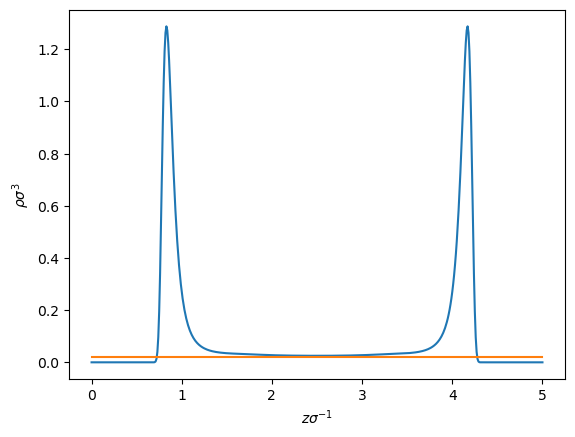

In [ ]:
#Picard

accu = 1
tol = 1e-10
alpha = 0.2
itera = 0

rho_vec = np.zeros((Nump))+rho_H
rho_vec_new = np.zeros((Nump))


while accu == 1:
    itera += 1
    dFhs = calc_dFHS(H, Omega_vec, rho_vec, Nump, dz, T, d_HS, Z_vec)
    rho_vec_new = np.exp(mu_H/T-Vext_vec/T-dFhs/T)
    err = sum((rho_vec_new-rho_vec)**2)/(Nump)
    if (err<tol):
        accu = 0
    rho_vec = (1.-alpha)*rho_vec+alpha*rho_vec_new
    #print(itera,err)



rho_H_vec = np.zeros((Nump))+rho_H
plt.plot(Z_vec,rho_vec)
plt.plot(Z_vec,rho_H_vec)
plt.ylabel(r"$\rho \sigma^3$")
plt.xlabel("$z \sigma^{-1}$")

plt.show()

### So, considering the problem of simulating hard-spheres in a slit pore, the code below can be used to produce isotherms.


In [ ]:
#P = ((P*1.e5)/(kb*E_eff)*(Sigma_ff*1.e-10)**3)

import numpy as np

# Definindo as variáveis necessárias
rho_H = [0.1, 0.3, 0.7, 0.9]
Sigma_ff = 1.0  # Valor de exemplo para Sigma_ff (defina conforme necessário)
T = 3  # Valor de exemplo para T (defina conforme necessário)
kb = 1.38e-23  # Constante de Boltzmann em J/K
E_eff = 1.0  # Valor de exemplo para E_eff (defina conforme necessário)

# Inicializando a lista para armazenar os valores de P_cs
P_cs_list = []

# Iterando sobre cada elemento de rho_H
for rho in rho_H:
    Eta = np.pi * rho * Sigma_ff**3 / 6
    P_cs = T * rho * (1 + Eta + Eta**2 - Eta**3) / (1 - Eta)**3
    P_cs_list.append(P_cs)

print("P_cs_list:", P_cs_list)

# Convertendo a lista para um array numpy para operações matemáticas
P_cs_array = np.array(P_cs_list)

# Calculando P a partir de P_cs_array
P = (P_cs_array / 1.e5) * (kb * E_eff) / (Sigma_ff * 1.e-10)**3

print("P:", P)

# Recalculando P com a fórmula corrigida
P_corrected = ((P * 1.e5) / (kb * E_eff)) * (Sigma_ff * 1.e-10)**3

print("P_corrected:", P_corrected)

P_cs_list: [0.37189989643775295, 1.7700401781787916, 11.991439866568772, 29.014554293766228]
P: [  51.32218571  244.26554459 1654.81870159 4004.00849254]
P_corrected: [ 0.3718999   1.77004018 11.99143987 29.01455429]


1 0.022172287361483682
2 0.022157039632920192
3 0.02214180355014155
4 0.02212657910324435
5 0.022111366282335544
6 0.02209616507753098
7 0.02208097547895581
8 0.022065797476744944
9 0.02205063106104203
10 0.02203547622200044
11 0.02202033294978324
12 0.022005201234562413
13 0.02199008106651916
14 0.021974972435844092
15 0.021959875332737546
16 0.021944789747408454
17 0.02192971567007575
18 0.02191465309096707
19 0.021899602000319523
20 0.021884562388379453
21 0.021869534245402663
22 0.02185451756165396
23 0.021839512327407214
24 0.021824518532946084
25 0.02180953616856291
26 0.021794565224559175
27 0.02177960569124612
28 0.021764657558943554
29 0.021749720817980923
30 0.021734795458696454
31 0.021719881471437746
32 0.021704978846561557
33 0.02169008757443364
34 0.021675207645428966
35 0.021660339049931476
36 0.02164548177833447
37 0.02163063582103989
38 0.021615801168459462
39 0.02160097781101325
40 0.021586165739130875
41 0.02157136494325082
42 0.02155657541382038
43 0.021541797141296

372 0.01723786048942097
373 0.01722632592207709
374 0.017214799896078298
375 0.017203282404414297
376 0.017191773440081312
377 0.017180272996081637
378 0.017168781065424205
379 0.017157297641123975
380 0.017145822716202748
381 0.01713435628368834
382 0.017122898336615105
383 0.017111448868023762
384 0.017100007870961033
385 0.01708857533848043
386 0.01707715126364171
387 0.017065735639510617
388 0.017054328459159638
389 0.01704292971566728
390 0.017031539402118497
391 0.017020157511604524
392 0.017008784037222745
393 0.01699741897207724
394 0.01698606230927773
395 0.016974714041940727
396 0.016963374163188768
397 0.01695204266615099
398 0.01694071954396201
399 0.016929404789763725
400 0.0169180983967036
401 0.016906800357935355
402 0.016895510666619134
403 0.016884229315921206
404 0.01687295629901412
405 0.01686169160907675
406 0.01685043523929371
407 0.01683918718285653
408 0.016827947432962186
409 0.016816715982814447
410 0.016805492825622766
411 0.01679427795460318
412 0.01678307136

723 0.013667498009486793
724 0.01365857280082119
725 0.013649654023479367
726 0.01364074167234387
727 0.013631835742301769
728 0.013622936228244759
729 0.01361404312506873
730 0.013605156427674455
731 0.01359627613096695
732 0.013587402229855721
733 0.01357853471925488
734 0.013569673594082964
735 0.013560818849262829
736 0.013551970479722042
737 0.01354312848039264
738 0.013534292846210797
739 0.013525463572117424
740 0.01351664065305779
741 0.013507824083981745
742 0.013499013859843296
743 0.013490209975601066
744 0.013481412426218243
745 0.013472621206662172
746 0.013463836311904781
747 0.013455057736922413
748 0.013446285476695696
749 0.013437519526209895
750 0.013428759880454564
751 0.01342000653442353
752 0.013411259483115317
753 0.013402518721532506
754 0.013393784244682277
755 0.01338505604757613
756 0.013376334125230082
757 0.0133676184726643
758 0.013358909084903416
759 0.013350205956976613
760 0.013341509083917114
761 0.013332818460762655
762 0.013324134082555446
763 0.01331

1073 0.010902806441154609
1074 0.010895849063578813
1075 0.010888896573001787
1076 0.010881948965645231
1077 0.010875006237733834
1078 0.010868068385495836
1079 0.010861135405162413
1080 0.01085420729296808
1081 0.010847284045150679
1082 0.010840365657951044
1083 0.010833452127613288
1084 0.010826543450384682
1085 0.010819639622515902
1086 0.010812740640260554
1087 0.010805846499875479
1088 0.010798957197620869
1089 0.010792072729759964
1090 0.010785193092559252
1091 0.010778318282288387
1092 0.01077144829522004
1093 0.010764583127630387
1094 0.010757722775798414
1095 0.010750867236006533
1096 0.01074401650454015
1097 0.01073717057768805
1098 0.010730329451741924
1099 0.010723493122996709
1100 0.010716661587750588
1101 0.010709834842304774
1102 0.010703012882963667
1103 0.01069619570603475
1104 0.01068938330782889
1105 0.010682575684659775
1106 0.010675772832844318
1107 0.010668974748702662
1108 0.010662181428558088
1109 0.0106553928687369
1110 0.010648609065568493
1111 0.0106418300153

1397 1.5487200579560346e-06
1398 1.487389770329415e-06
1399 1.4285053149907448e-06
1400 1.3719681423814247e-06
1401 1.317683733283904e-06
1402 1.2655614304974329e-06
1403 1.215514277749758e-06
1404 1.1674588655198805e-06
1405 1.121315183465505e-06
1406 1.0770064791612043e-06
1407 1.0344591228667268e-06
1408 9.9360247806025e-07
1409 9.543687774801464e-07
1410 9.166930044348563e-07
1411 8.805127791465294e-07
1412 8.457682499099649e-07
1413 8.124019888549743e-07
1414 7.803588921103799e-07
1415 7.495860841789483e-07
1416 7.200328263392293e-07
1417 6.916504288993499e-07
1418 6.643921671353899e-07
1419 6.382132007560885e-07
1420 6.130704967400622e-07
1421 5.889227554004249e-07
1422 5.657303395387493e-07
1423 5.43455206554524e-07
1424 5.220608433835788e-07
1425 5.015122041444701e-07
1426 4.817756503771919e-07
1427 4.628188937628233e-07
1428 4.4461094121886175e-07
1429 4.271220422694014e-07
1430 4.1032363859278484e-07
1431 3.9418831565479987e-07
1432 3.78689756338905e-07
1433 3.638026964891313

99 0.17121432005330928
100 0.17093693331589016
101 0.1706601802622872
102 0.17038405908453322
103 0.1701085679808009
104 0.16983370515538643
105 0.16955946881867684
106 0.16928585718712902
107 0.16901286848325436
108 0.16874050093557477
109 0.16846875277861967
110 0.16819762225289073
111 0.16792710760484408
112 0.16765720708686294
113 0.16738791895723262
114 0.16711924148012638
115 0.16685117292557533
116 0.1665837115694429
117 0.16631685569340754
118 0.1660506035849419
119 0.1657849535372802
120 0.1655199038494076
121 0.16525545282602813
122 0.16499159877755004
123 0.16472834002005396
124 0.16446567487528393
125 0.16420360167061146
126 0.16394211873902623
127 0.1636812244191007
128 0.16342091705498296
129 0.16316119499636447
130 0.1629020565984601
131 0.16264350022199253
132 0.16238552423316455
133 0.16212812700363943
134 0.16187130691052062
135 0.16161506233633124
136 0.16135939166899116
137 0.16110429330179823
138 0.16084976563340334
139 0.16059580706779716
140 0.16034241601428248
1

469 0.10035142056049502
470 0.10022256888951403
471 0.1000939590939947
472 0.0999655905995974
473 0.09983746283360541
474 0.09970957522492037
475 0.09958192720405638
476 0.09945451820313446
477 0.09932734765587901
478 0.09920041499760775
479 0.09907371966523325
480 0.09894726109725432
481 0.09882103873374744
482 0.09869505201636965
483 0.09856930038834569
484 0.09844378329446662
485 0.09831850018108543
486 0.09819345049610914
487 0.09806863368899613
488 0.09794404921074927
489 0.09781969651391241
490 0.0976955750525655
491 0.09757168428231726
492 0.09744802366030189
493 0.09732459264517705
494 0.09720139069711205
495 0.09707841727778853
496 0.09695567185039387
497 0.0968331538796161
498 0.09671086283164014
499 0.09658879817414037
500 0.09646695937627735
501 0.0963453459086951
502 0.09622395724351306
503 0.09610279285432215
504 0.09598185221618173
505 0.09586113480561277
506 0.09574064010059334
507 0.09562036758055607
508 0.09550031672637932
509 0.09538048702038934
510 0.095260877946346

820 0.06669811413432487
821 0.06662786278612745
822 0.06655772293930437
823 0.06648769436554924
824 0.06641777683711278
825 0.06634797012680217
826 0.0662782740079787
827 0.06620868825455671
828 0.06613921264100234
829 0.06606984694233026
830 0.06600059093410461
831 0.06593144439243516
832 0.06586240709397718
833 0.06579347881593006
834 0.06572465933603407
835 0.06565594843257139
836 0.06558734588436187
837 0.06551885147076336
838 0.06545046497167042
839 0.06538218616751101
840 0.06531401483924668
841 0.06524595076836977
842 0.06517799373690318
843 0.06511014352739891
844 0.06504239992293412
845 0.06497476270711368
846 0.06490723166406472
847 0.06483980657843785
848 0.06477248723540482
849 0.06470527342065682
850 0.06463816492040317
851 0.06457116152137064
852 0.0645042630107999
853 0.06443746917644677
854 0.06437077980657953
855 0.0643041946899767
856 0.0642377136159268
857 0.06417133637422635
858 0.06410506275517888
859 0.0640388925495936
860 0.06397282554878203
861 0.063906861544560

1168 0.04767299161479516
1169 0.04763086781059069
1170 0.04758880118074516
1171 0.04754679162256895
1172 0.04750483903359291
1173 0.0474629433115693
1174 0.047421104354471076
1175 0.04737932206049082
1176 0.04733759632803913
1177 0.047295927055747075
1178 0.0472543141424629
1179 0.047212757487251636
1180 0.04717125698939667
1181 0.047129812548397196
1182 0.047088424063968765
1183 0.04704709143604194
1184 0.04700581456476225
1185 0.0469645933504899
1186 0.046923427693798085
1187 0.046882317495474335
1188 0.046841262656518605
1189 0.046800263078142224
1190 0.04675931866176963
1191 0.04671842930903526
1192 0.04667759492178456
1193 0.04663681540207354
1194 0.046596090652168035
1195 0.046555420574541186
1196 0.04651480507187696
1197 0.04647424404706656
1198 0.0464337374032077
1199 0.04639328504360658
1200 0.04635288687177547
1201 0.04631254279143233
1202 0.04627225270650054
1203 0.046232016521109934
1204 0.04619183413959261
1205 0.04615170546648634
1206 0.0461116304065317
1207 0.04607160886

1511 0.03600055376091041
1512 0.03597323199916766
1513 0.035945942223819714
1514 0.03591868438391409
1515 0.03589145842859773
1516 0.035864264307115166
1517 0.035837101968809
1518 0.03580997136312048
1519 0.03578287243958757
1520 0.03575580514784646
1521 0.035728769437629905
1522 0.0357017652587679
1523 0.03567479256118734
1524 0.03564785129491175
1525 0.03562094141006057
1526 0.03559406285684982
1527 0.035567215585591
1528 0.03554039954669206
1529 0.03551361469065554
1530 0.035486860968080305
1531 0.03546013832965881
1532 0.03543344672617981
1533 0.03540678610852602
1534 0.03538015642767457
1535 0.0353535576346973
1536 0.035326989680759466
1537 0.035300452517120176
1538 0.035273946095132964
1539 0.035247470366243476
1540 0.03522102528199177
1541 0.03519461079401013
1542 0.03516822685402359
1543 0.035141873413850284
1544 0.03511555042540026
1545 0.03508925784067583
1546 0.035062995611771335
1547 0.0350367636908729
1548 0.03501056203025822
1549 0.034984390582295875
1550 0.03495824929944

1850 0.028289376553532943
1851 0.028270511575675932
1852 0.028251665791979262
1853 0.028232839175161173
1854 0.028214031697988574
1855 0.028195243333276207
1856 0.028176474053885535
1857 0.02815772383272655
1858 0.02813899264275659
1859 0.028120280456979674
1860 0.028101587248447697
1861 0.028082912990259317
1862 0.028064257655560348
1863 0.02804562121754373
1864 0.02802700364944915
1865 0.02800840492456297
1866 0.027989825016218602
1867 0.027971263897795463
1868 0.027952721542719963
1869 0.027934197924464606
1870 0.02791569301654831
1871 0.027897206792536374
1872 0.027878739226039607
1873 0.02786029029071569
1874 0.02784185996026748
1875 0.027823448208444092
1876 0.027805055009040455
1877 0.027786680335896614
1878 0.027768324162898584
1879 0.027749986463978298
1880 0.027731667213111714
1881 0.027713366384321467
1882 0.02769508395167463
1883 0.02767681988928355
1884 0.02765857417130569
1885 0.027640346771943308
1886 0.027622137665443313
1887 0.02760394682609802
1888 0.02758577422824319

2216 0.0224764041100631
2217 0.022463068397848035
2218 0.022449744440282936
2219 0.022436432222562416
2220 0.022423131729904636
2221 0.02240984294755099
2222 0.02239656586076616
2223 0.022383300454838693
2224 0.02237004671508019
2225 0.022356804626825176
2226 0.022343574175431834
2227 0.02233035534628211
2228 0.022317148124779577
2229 0.022303952496352364
2230 0.022290768446451118
2231 0.022277595960549214
2232 0.02226443502414394
2233 0.02225128562275444
2234 0.022238147741923436
2235 0.022225021367216262
2236 0.02221190648422145
2237 0.02219880307854962
2238 0.0221857111358347
2239 0.022172630641733016
2240 0.02215956158192397
2241 0.02214650394210875
2242 0.022133457708012238
2243 0.022120422865380674
2244 0.0221073993999836
2245 0.022094387297612872
2246 0.022081386544082503
2247 0.022068397125228862
2248 0.022055419026911063
2249 0.022042452235009977
2250 0.022029496735428932
2251 0.022016552514093582
2252 0.022003619556951556
2253 0.02199069784997275
2254 0.021977787379148808
225

2569 0.018404798090439323
2570 0.018394838671561872
2571 0.018384886974707988
2572 0.01837494299121329
2573 0.01836500671242617
2574 0.018355078129707166
2575 0.018345157234429497
2576 0.018335244017978886
2577 0.01832533847175363
2578 0.018315440587164337
2579 0.01830555035563379
2580 0.01829566776859775
2581 0.018285792817503668
2582 0.018275925493812024
2583 0.018266065788995103
2584 0.018256213694537796
2585 0.01824636920193718
2586 0.018236532302702595
2587 0.01822670298835572
2588 0.018216881250430323
2589 0.018207067080472338
2590 0.01819726047004022
2591 0.018187461410704448
2592 0.018177669894047187
2593 0.018167885911663465
2594 0.01815810945515982
2595 0.018148340516155374
2596 0.01813857908628071
2597 0.018128825157179188
2598 0.018119078720505513
2599 0.018109339767926762
2600 0.01809960829112186
2601 0.01808988428178195
2602 0.01808016773160962
2603 0.018070458632319826
2604 0.018060756975639317
2605 0.01805106275330658
2606 0.018041375957072166
2607 0.018031696578698256


2898 0.015499251748006605
2899 0.015491430058801456
2900 0.015483613809442963
2901 0.015475802994445653
2902 0.015467997608331308
2903 0.015460197645629252
2904 0.01545240310087565
2905 0.01544461396861444
2906 0.015436830243396434
2907 0.01542905191977985
2908 0.015421278992329908
2909 0.01541351145561945
2910 0.015405749304228352
2911 0.015397992532743293
2912 0.015390241135758879
2913 0.015382495107876211
2914 0.015374754443703908
2915 0.01536701913785775
2916 0.015359289184960259
2917 0.015351564579641664
2918 0.015343845316539
2919 0.01533613139029621
2920 0.015328422795564832
2921 0.01532071952700307
2922 0.015313021579276276
2923 0.01530532894705709
2924 0.01529764162502479
2925 0.015289959607866055
2926 0.015282282890274453
2927 0.015274611466950635
2928 0.015266945332601983
2929 0.015259284481943372
2930 0.015251628909696049
2931 0.015243978610588925
2932 0.01523633357935706
2933 0.015228693810743224
2934 0.015221059299496744
2935 0.015213430040373847
2936 0.015205806028137692

3245 0.013077720984362488
3246 0.013071501891002105
3247 0.013065286703043898
3248 0.013059075416962015
3249 0.01305286802923493
3250 0.013046664536345117
3251 0.013040464934779537
3252 0.013034269221029527
3253 0.013028077391590518
3254 0.013021889442962115
3255 0.013015705371648449
3256 0.013009525174157694
3257 0.013003348847002185
3258 0.012997176386698806
3259 0.012991007789768222
3260 0.012984843052735952
3261 0.012978682172131112
3262 0.012972525144487245
3263 0.012966371966342198
3264 0.012960222634237845
3265 0.012954077144720511
3266 0.01294793549434039
3267 0.01294179767965203
3268 0.01293566369721418
3269 0.012929533543589496
3270 0.012923407215345229
3271 0.012917284709052438
3272 0.012911166021286358
3273 0.012905051148626542
3274 0.012898940087656576
3275 0.01289283283496407
3276 0.01288672938714085
3277 0.012880629740783153
3278 0.012874533892490582
3279 0.012868441838867742
3280 0.012862353576522568
3281 0.012856269102067686
3282 0.01285018841211927
3283 0.012844111503

KeyboardInterrupt: 

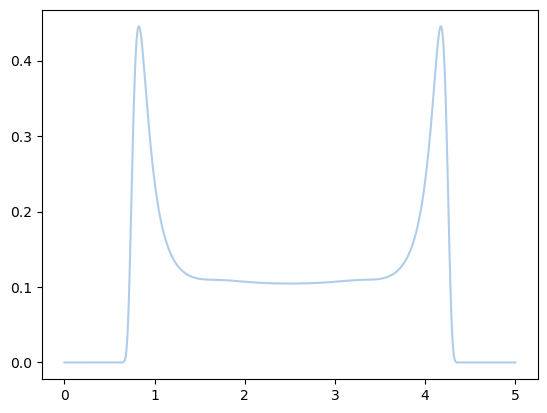

In [ ]:
#Chemical-Potential calculation

rho_H = [0.1,0.3,0.7,0.9]

#color
color=['#AFCDE9','#5C8FDB','#3469A4','#0F74E8','#00005A']

for k in range(len(rho_H)):
    #Ideal-Gas contribution
    mu_ID = T*np.log(rho_H[k])

    EtaH = np.pi*rho_H[k]*Sigma_ff**3/6.0

    mu_HS = T*(EtaH*(8.0-9.0*EtaH+3.*EtaH**2)/(1.-EtaH)**3)

    mu_H = mu_ID+mu_HS

    #print(mu_H)

#Picard

    rho_vec = np.zeros((Nump))+rho_H[k]
    rho_vec_new = np.zeros((Nump))

    accu = 1
    tol = 1e-10
    alpha = 0.0002
    itera = 0

    #rho_H = [0.1,0.3,0.7,0.9]


    while accu == 1:
        itera += 1
        dFhs = calc_dFHS(H, Omega_vec, rho_vec, Nump, dz, T, d_HS, Z_vec)
        rho_vec_new = np.exp(mu_H/T-Vext_vec/T-dFhs/T)
        err = sum((rho_vec_new-rho_vec)**2)/(Nump)
        if (err<0.01):
            alpha = 0.02
        if (err<tol):
            accu = 0
        rho_vec = (1.-alpha)*rho_vec+alpha*rho_vec_new
        print(itera,err)
    plt.plot(Z_vec, rho_vec, color=color[k], label=r'$\rho_b\sigma^3 = $'+str(rho_H[k]))



# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.ylabel(r"$\rho \sigma^3$",fontsize=16)
plt.xlabel("$z \sigma^{-1}$",fontsize=16)


plt.legend()

plt.tight_layout()

plt.savefig('HowToDo/Figuras/Rho_hs.pdf')

plt.show()


In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from scipy.optimize import minimize
import FMT_mod as fmt
from numba import jit

#%%
#Temperature of the system [K]
T = 100.
#Volumar Pressure [Bar]
P = np.linspace(0.001,100.,100)
P_bar = P
#LJ Properties of the molecule probe
Sigma_ff = 3.305 #A
Sigma_ori=Sigma_ff
d_HS = 3.38#Sigma_ff
Eps_kb = 118.05 #K
#LJ Properties of the wall
E_eff = 17.61
Sigma_sf = 3.494
#Boltzmann constant
kb = 1.3806488e-23
#%%

# T[K] / Eps_kb[K]
T = T/Eps_kb

# bar -> Pa (kg/m s^2)
# kb [kg⋅m2⋅s−2/K] * Eps_kb[K] * Sigma_ff*1.e-10)**3 [m^3] ~ [kg/m s^2]
P = ((P*1.e5)/(kb*Eps_kb)*(Sigma_ff*1.e-10)**3)

# E_eff[K/A^2] / Eps_kb[K] * Sigma_ff^2 [A^2]
E_eff = E_eff#/Eps_kb*(Sigma_ff*Sigma_ff)

# Eps_kb[K]
Eps_kb = Eps_kb/Eps_kb

#d_HS[A] / Sigma_ff[A]
d_HS = d_HS/Sigma_ff

#Sigma_sf[A]/Sigma_ff[A]
Sigma_sf = Sigma_sf/Sigma_ff

#Sigma_ff[A]
Sigma_ff = Sigma_ff/Sigma_ff
#R_cut
rc_MF = 5.*Sigma_ff

#%%

#Number of points of the grid
Nump = 501
#Step size on z direction
dz  = 0.01
#Tamanho
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)


#%%
#Calculating Rho_H

def Fobj_Rho(rho0):
    #Initial guess
    Eta = np.pi*rho0*Sigma_ff**3/6.
    #Carnahan–Starling equation of state
    P_cs = T*rho0*(1+Eta+Eta**2-Eta**3)/(1-Eta)**3
    #Mean-Field
    P_c = P_cs
    return (P_c-P_in)**2

rho_H = np.zeros(len(P))
for i in range(len(P)):
    P_in = P[i]
    minval = minimize(Fobj_Rho, 1.e-7, method='BFGS')
    rho_H[i] = minval.x



#%%
#Chemical-Potential calculation

#Ideal-Gas contribution
mu_ID = T*np.log(rho_H)

EtaH = np.pi*rho_H*Sigma_ff**3/6.0

mu_HS = T*(EtaH*(8.0-9.0*EtaH+3.*EtaH**2)/(1.-EtaH)**3)

mu_H = mu_ID+mu_HS


def Phi_ext(E_eff,Sigma_sf,dist):
    delta = 3.35/Sigma_ori
    if dist != 0:
        return E_eff*(0.4*(Sigma_sf/dist)**10-(Sigma_sf/dist)**4-(Sigma_sf**4/(3.*delta*(0.61*delta+dist)**3)))
    elif dist == 0:
        return 1e200

Vext_vec = np.zeros(Nump)

for i in range(Nump):
    Vext_vec[i] = T*Phi_ext(E_eff,Sigma_sf,Z_vec[i]) + \
                  T*Phi_ext(E_eff,Sigma_sf,H-Z_vec[i])

#Calculation of the FMT weighting functions
N_poid = fmt.N_poid_calc(H, Nump, Sigma_ff, Z_vec)

from scipy import integrate

Nads = np.zeros(len(P))

#Initial guess
rho_vec = np.zeros((Nump))+rho_H[0]
rho_vec_new = np.zeros((Nump))

for i in range(len(P)):
    #accuses the convergence of the method
    accu = 1

    #Tolerance
    tol = 1.e-7

    #mixing parameter
    alpha = 0.002

    #tracking the iterations
    itera = 0

    while accu == 1:
        itera += 1
        dFhs = fmt.calc_dFHS(H, N_poid, rho_vec, Nump, dz, T, d_HS, Z_vec)
        rho_vec_new = np.exp(mu_H[i]/T-Vext_vec/T-dFhs/T)

        err = sum((rho_vec_new-rho_vec)**2)/(Nump)
        if (err<0.01):
            alpha = 0.02
        if (err<tol):
            accu = 0
        rho_vec = (1.-alpha)*rho_vec+alpha*rho_vec_new
        #print(err)
    Nads[i] = integrate.trapz(rho_vec,Z_vec)/(H-Sigma_sf)
    print(i,P[i],rho_H[i],Nads[i])
    #rho_H_vec = np.zeros((Nump))+rho_H[i]
    plt.plot(Z_vec,rho_vec,label="P ="+str(P[i]))
    #plt.plot(Z_vec,rho_H_vec)


In [ ]:
plt.plot(P_bar,Nads)
plt.scatter(P_bar,Nads)


# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.xlabel('$P\sigma_{ref}^3/\epsilon_{ref}$',fontsize=16)
plt.ylabel(r"$\Gamma\sigma^2$",fontsize=16)

plt.tight_layout()

plt.savefig('HowToDo/Figuras/iso_hs.pdf')

plt.show()

## Dispersive contribution - Mean-field approach

### The term of dispersive contributions will represent the attractions that the fluid molecules have with each other. Considering the mean-field approximation, the residual dispersive free energy term ($F_{disp}$) is described as a functional of the density of the fluid by,

## $F_{disp}[\rho(\textbf{r})] = \frac{1}{2}\int \int \rho(\textbf{r})\rho(\textbf{r'})\phi_{disp}(\left|\textbf{r}-\textbf{r'} \right|)\text{d}\textbf{r}\text{d}\textbf{r'}$

## $F_{disp}[\rho(\textbf{r})] = \frac{1}{2}\int \int \rho(\textbf{r})\rho(\textbf{r'})\phi_{disp}(\left|\textbf{r}-\textbf{r'} \right|)\text{d}\textbf{r}\text{d}\textbf{r'}$

## $$
\phi_{\text{disp}}^{\text{WCA}}(r) = \begin{cases}
0 & \text{if } r > 5\sigma \\
4\epsilon\left[\left(\frac{\sigma}{r}\right)^{12}-2\left(\frac{\sigma}{r}\right)^{6}\right] & \text{if } 2^{\frac{1}{6}}\sigma \leq r \leq 5\sigma \\
-\epsilon & \text{if } r < 2^{\frac{1}{6}}\sigma
\end{cases}
$$


### In which $\sigma$ and $\epsilon$ are the Lennard-Jones parameters.
### Considering the case of the uniform fluid, this description is consistent with the following additive contribution to the equation of state:

## $\mu_{disp} = \rho_b \int \phi_{disp}(\textbf{r}) \text{d}\textbf{r}$

## $P_{disp} = \frac{1}{2} \rho_b^2 \int \phi_{disp}(\textbf{r}) \text{d}\textbf{r} $

## In which $\rho_b$ is the bulk fluid density, and considering the WCA potential:

## $\int \phi_{disp}(\textbf{r}) \text{d}\textbf{r} = -\sqrt{2}\frac{32}{9}\pi \epsilon \sigma^3 + \frac{16}{3}\pi \epsilon \sigma \left[ \left(\frac{\sigma}{r_c} \right)^3-\frac{1}{3} \left(\frac{\sigma}{r_c} \right)^9 \right]$

### In which rc is the cuttof radius. Here we considered rc = 5 $\sigma$.

### To obtain the volumetric properties of a fluid with its parameters and T and P described below.

In [ ]:
#Temperature of the system [K]
T = 80.
#Volumar Pressure [Bar]
P = 1.
#LJ Properties of the molecule probe
Sigma_ff = 3.305 #A
d_HS = 3.38#Sigma_ff
Eps_kb = 118.05 #K
#Boltzmann constant
kb = 1.3806488e-23

### Removing the dimension of the variables

In [ ]:
# T[K] / Eps_kb[K]
T = T/Eps_kb

# bar -> Pa (kg/m s^2)
# kb [kg⋅m2⋅s−2/K] * Eps_kb[K] * Sigma_ff*1.e-10)**3 [m^3] ~ [kg/m s^2]
P = ((P*1.e5)/(kb*Eps_kb)*(Sigma_ff*1.e-10)**3)

# E_eff[K/A^2] / Eps_kb[K] * Sigma_ff^2 [A^2]
E_eff = 17.61#E_eff/Eps_kb*(Sigma_ff*Sigma_ff)

# Eps_kb[K]
Eps_kb = Eps_kb/Eps_kb

#d_HS[A] / Sigma_ff[A]
d_HS = d_HS/Sigma_ff

#Sigma_sf[A]/Sigma_ff[A]
Sigma_sf = Sigma_sf/Sigma_ff

#Sigma_ff[A]
Sigma_ff = Sigma_ff/Sigma_ff

#R_cut of the WCA potential
rc_MF = 5.*Sigma_ff

### We obtain the mean bulk density of the fluid.

In [ ]:
#%%
#Calculating Rho_H

def Fobj_Rho(rho0):
    #Initial guess
    Eta = np.pi*rho0*Sigma_ff**3/6.
    #Carnahan–Starling equation of state
    P_cs = T*rho0*(1+Eta+Eta**2-Eta**3)/(1-Eta)**3
    #Mean-Field
    P_MF_WCA = rho0**2*0.5*(-np.sqrt(2)*(32./9.)*np.pi*Eps_kb*Sigma_ff**3 +
              (16./3.)*np.pi*Eps_kb*Sigma_ff**3*((Sigma_ff/(rc_MF))**3 -
              (1./3.)*(Sigma_ff/(5.*rc_MF))**9))
    P_c = P_cs+P_MF_WCA
    return (P_c-P)**2

min_val = minimize(Fobj_Rho, 1.e-7, method='BFGS')

rho_H = min_val.x

### And we calculate the chemical pontential

In [ ]:
#%%
#Chemical-Potential calculation

#Ideal-Gas contribution
mu_ID = T*np.log(rho_H)


#Hard-Sphere Contribution
EtaH = np.pi*rho_H*Sigma_ff**3/6.0
mu_HS = T*(EtaH*(8.0-9.0*EtaH+3.*EtaH**2)/(1.-EtaH)**3)


#Dispersive contribution
mu_MF_WCA = rho_H*(-np.sqrt(2)*(32./9.)*np.pi*Eps_kb*Sigma_ff**3 +
          (16./3.)*np.pi*Eps_kb*Sigma_ff**3*((Sigma_ff/(5.*Sigma_ff))**3 -
          (1./3.)*(Sigma_ff/(5.*Sigma_ff))**9))

#Total Amount
mu_H = mu_ID+mu_HS+mu_MF_WCA

### To transform the interaction potential between two fluid plates, consider the problem described below in cylindrical coordinates, where r represents the distance between a position on the fluid plate on the right located at z = z, and a point on another fluid plate located at z=z'.

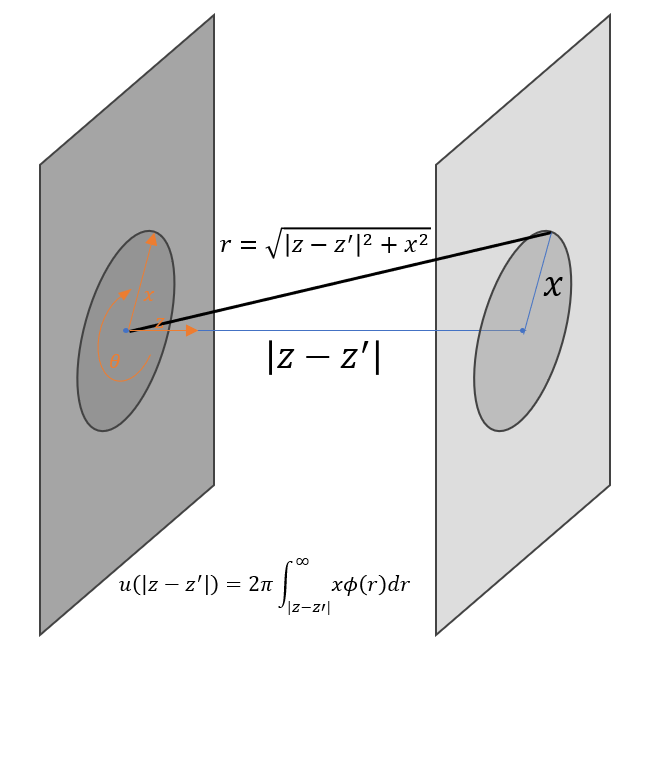

### This allows us to describe the potential ($u(|z-z'|)$) due to a single plane at a distance $|z-z'|$ as:

## $u(|z-z'|) = 2 \pi \int_{|z-z'|}^\infty x \phi(\text{r}) \text{d}\textbf{r}$

### knowing that,

## $r = \sqrt{|z-z'|^2+x^2}$
## $\text{d}(r) = \text{d}(\sqrt{|z-z'|^2+x^2})$

## $\text{d}r = \frac{x}{\sqrt{|z-z'|^2+x^2}}\text{d}x$

## $\text{d}r = \frac{x}{r}\text{d}x$

## $r\text{d}r = x\text{d}x$


### Thus

## $u(|z-z'|) = 2 \pi \int_{|z-z'|}^\infty r \phi(r) \text{d}r$

### This strategy, if used for a Lennard-Jones potential, allows the 10-4 planar wall potential to be found.

### For the WCA potential we should consider when the distance between the planes ($|z-z'|$) is less than $r_{min}$:

## $u(|z-z'|) =  2 \pi \int_{|z-z'|}^\infty r \phi(r) \text{d}r $

## $=  2 \pi \int_{|z-z'|}^{r_{min}} r \phi(r) \text{d}r + 2 \pi \int_{r_{min}}^{r_c} r \phi(r) \text{d}r+0$

## $=  2 \pi \int_{|z-z'|}^{r_{min}}  -\epsilon r \text{d}r + 2 \pi \int_{r_{min}}^{r_c} r\left[\left(\frac{\sigma}{r}\right)^{12}-2\left(\frac{\sigma}{r}\right)^{6}\right] \text{d}r$

## $=  \epsilon \pi \left((|z-z'|^2 - r_{min})^2  \right) + 2 \pi \epsilon \sigma^2 \left[\frac{2}{5}\left(\left(\frac{\sigma}{r_{min}} \right)^{10}-\left(\frac{\sigma}{r_c} \right)^{10} \right)+\left(\left(\frac{\sigma}{r_{c}} \right)^4-\left(\frac{\sigma}{r_{min}} \right)^{4} \right) \right]$

### If the distance between the two planes is greater than $r_{min}$ and less than the cutting radius ($r_c$):

## $u(|z-z'|) = 2 \pi \int_{|z-z'|}^{r_c} r \phi(r) \text{d}r+0$

## $=  2 \pi \int_{|z-z'|}^{r_c} r\left[\left(\frac{\sigma}{r}\right)^{12}-2\left(\frac{\sigma}{r}\right)^{6}\right] \text{d}r$

## $= 2 \pi \epsilon \sigma^2 \left[\frac{2}{5}\left(\left(\frac{\sigma}{|z-z'|} \right)^{10}-\left(\frac{\sigma}{r_c} \right)^{10} \right)+\left(\left(\frac{\sigma}{r_{c}} \right)^4-\left(\frac{\sigma}{|z-z'|} \right)^{4} \right) \right]$

### So for a one-dimensional problem the WCA potential can be rewritten in the form:

$$
\phi_{\text{disp}}^{\text{WCA}}(|z-z'|) = \begin{cases}
0 & \text{if } r > 5\sigma \\
2 \pi \epsilon \sigma^2 \left[\frac{2}{5}\left(\left(\frac{\sigma}{|z-z'|} \right)^{10}-\left(\frac{\sigma}{r_c} \right)^{10} \right)+\left(\left(\frac{\sigma}{r_{c}} \right)^4-\left(\frac{\sigma}{|z-z'|} \right)^{4} \right) \right] & \text{if } r_{rmin} \leq |z-z'| \leq r_c \\
\epsilon \pi \left((|z-z'|^2 - r_{min})^2  \right) + 2 \pi \epsilon \sigma^2 \left[\frac{2}{5}\left(\left(\frac{\sigma}{r_{min}} \right)^{10}-\left(\frac{\sigma}{r_c} \right)^{10} \right)+\left(\left(\frac{\sigma}{r_{c}} \right)^4-\left(\frac{\sigma}{r_{min}} \right)^{4} \right) \right] & \text{if } |z-z'| < r_{min}
\end{cases}
$$

### Where for WCA potential $r_{min} = 2^\frac{1}{6}\sigma$ and $r_c = 5\sigma$

### Below is a python function algorithm for calculating this potential, where dist represents $|z-z'|$, rc is $r_c$, eps and Sig_ff are the Lennard-Jones parameters of the fluid $\epsilon$ and $\sigma_{ff}$

In [ ]:
import numpy as np
from numba import jit

@jit(nopython=True)
def Phi_wca(dist,rc,eps,Sig_ff):
    rmin = 2.**(1./6.)*Sig_ff
    if dist>rc:
        return 0
    elif (dist>rmin and dist<=rc):
        Temp1 = (2./5.)*(eps*Sig_ff**12)/(dist**10)-eps*Sig_ff**6/(dist**4)
        Temp2 = (2./5.)*(eps*Sig_ff**12)/(rc**10)-eps*Sig_ff**6/(rc**4)
        return  2.*np.pi*(Temp1 - Temp2)
    else:
        Temp0 = 0.5*eps*(dist**2-rmin**2)
        Temp1 = (2./5.)*(eps*Sig_ff**12)/(rmin**10)-eps*Sig_ff**6/(rmin**4)
        Temp2 = (2./5.)*(eps*Sig_ff**12)/(rc**10)-eps*Sig_ff**6/(rc**4)
        return 2.*np.pi*(Temp0 + Temp1 - Temp2)

## Knowing how to calculate the WCA potential, it is necessary to solve the dispersive contribution of the functional derivative of the free energy in relation to the particle density:

## $\frac{\delta F_{MF}[\rho(\textbf{r})]}{\delta\rho(\textbf{r})}=\frac{\delta}{\delta\rho(\textbf{r})}\frac{1}{2}\int \int \rho(\textbf{r'})\rho(\textbf{r''})\phi(|\textbf{r'}-\textbf{r''}|)\text{d}\textbf{r'}\text{d}\textbf{r''}$

## $\frac{\delta F_{MF}[\rho(\textbf{r})]}{\delta\rho(\textbf{r})}=\frac{1}{2} \int \int \frac{\delta\rho(\textbf{r'})}{\delta\rho(\textbf{r})}\rho(\textbf{r''})\phi(|\textbf{r'}-\textbf{r''}|)\text{d}\textbf{r'}\text{d}\textbf{r''}+\frac{1}{2} \int \int \rho(\textbf{r''})\frac{\delta\rho(\textbf{r'})}{\delta\rho(\textbf{r})}\phi(|\textbf{r'}-\textbf{r''}|)\text{d}\textbf{r'}\text{d}\textbf{r''}$

## $\frac{\delta F_{MF}[\rho(\textbf{r})]}{\delta\rho(\textbf{r})}=\frac{1}{2} \int \int \delta(\textbf{r'}-\textbf{r})\rho(\textbf{r''})\phi(|\textbf{r'}-\textbf{r''}|)\text{d}\textbf{r'}\text{d}\textbf{r''}+\frac{1}{2} \int \int \delta(\textbf{r''}-\textbf{r}) \rho(\textbf{r'})\phi(|\textbf{r'}-\textbf{r''}|)\text{d}\textbf{r'}\text{d}\textbf{r''}$

## $\frac{\delta F_{MF}[\rho(\textbf{r})]}{\delta\rho(\textbf{r})}=\frac{1}{2} \int \rho(r'')\phi(|\textbf{r}-\textbf{r''}|)\text{d}\textbf{r''}+\frac{1}{2}\int \rho(\textbf{r'})\phi(|\textbf{r'}-\textbf{r}|)\text{d}\textbf{r'}$

## $\frac{\delta F_{MF}[\rho(\textbf{r})]}{\delta\rho(\textbf{r})}=\int \rho(\textbf{r'})\phi(|\textbf{r'}-\textbf{r}|)\text{d}\textbf{r'}$

### As with the FMT, the weights relating each grid point can be calculated in advance. In the case of simulating a 1D box, the densities will be convoluted using an Np x Np matrix, where Np is the number of grid points. Each element of this matrix shows the potential between these two positions.  Below is a function algorithm for evaluating this matrix where Z_vec is the position vector, rc is the WCA cut radius, eps and sig_ff are the Lennard-Jones parameters.

In [ ]:
@jit(nopython=True)
def MF_phi(Z_vec,rc,eps,Sig_ff):
    Phi_att = np.zeros((len(Z_vec),len(Z_vec)))
    for j in range(len(Z_vec)):
        for i in range(len(Z_vec)):
           Phi_att[i,j] = Phi_wca(abs(Z_vec[i]-Z_vec[j]),rc,eps,Sig_ff)
    return Phi_att

### And with these functions the derivative of the free energy for the dispersive contribution can be calculated by the convolution below.

In [ ]:
@jit(nopython=True)
def calc_dFAtt(H, MF, rho_vec, Nump, dz, Sigma_ff, eps, Z_vec, rc):
    conv = np.sum(MF * rho_vec, axis=1)
    FAtt = conv * dz
    return FAtt

### Below is an example for the evaluation of the adsorption isotherm for argon on graphite:

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from scipy.optimize import minimize
import FMT_mod as fmt
import MF_mod as wca
from numba import jit

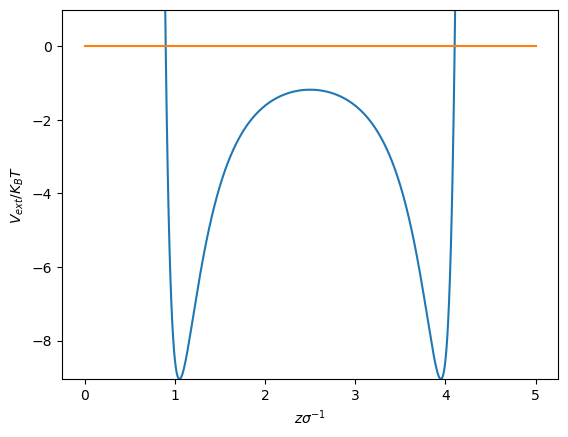

0 2.214956392092312e-06 1e-07 0.001357805746862296
1 4.429912784184624e-06 1e-07 0.0013579034566414355
2 6.644869176276936e-06 1e-07 0.0013580010797176177
3 8.859825568369248e-06 1.3042211470195684e-05 0.2752902027011896
4 1.1074781960461561e-05 1.6306944257742688e-05 0.28926802980048705
5 1.3289738352553873e-05 1.957167704529143e-05 0.30019245778850506
6 1.5504694744646184e-05 2.28364098328367e-05 0.3093219903021569
7 1.7719651136738496e-05 2.610114262038544e-05 0.3173229530988218
8 1.993460752883081e-05 2.9365875407934182e-05 0.32459931645531026
9 2.2149563920923125e-05 3.2630608195482926e-05 0.3314149171286799
10 2.436452031301543e-05 3.589534098303167e-05 0.3379662709717301
11 2.6579476705107745e-05 3.916007377057347e-05 0.3444149527913838
12 2.8794433097200057e-05 4.242480655812915e-05 0.3509232379488891
13 3.1009389489292375e-05 4.568953934567789e-05 0.35766354236822356
14 3.3224345881384676e-05 4.895427213323357e-05 0.3648791094069475
15 3.543930227347699e-05 5.221900492078925e-

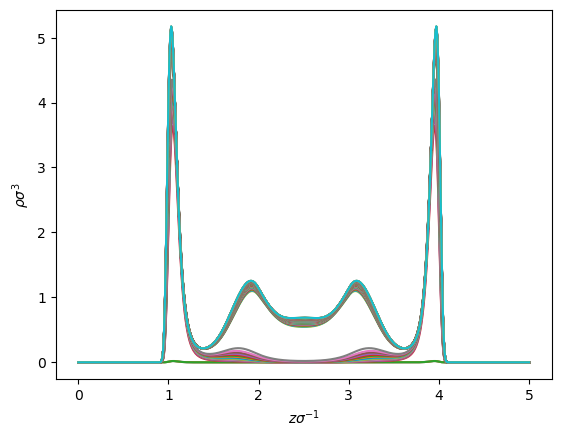

In [ ]:
#%%
#Temperature of the system [K]
T = 87.
#Volumar Pressure [Bar]
P = np.linspace(0.001,0.1,100)
#LJ Properties of the molecule probe
Sigma_ff = 3.305 #A
Sigma_ori=Sigma_ff
d_HS = 3.38#Sigma_ff
Eps_kb = 118.05 #K
#LJ Properties of the wall
E_eff = 17.61
Sigma_sf = 3.494
#Boltzmann constant
kb = 1.3806488e-23
#%%

#---------------------------------------------------------------------
#Nondimensionalization
#---------------------------------------------------------------------
# T[K] / Eps_kb[K]
T = T/Eps_kb

# bar -> Pa (kg/m s^2)
# kb [kg⋅m2⋅s−2/K] * Eps_kb[K] * Sigma_ff*1.e-10)**3 [m^3] ~ [kg/m s^2]
P = ((P*1.e5)/(kb*Eps_kb)*(Sigma_ff*1.e-10)**3)

# E_eff[K/A^2] / Eps_kb[K] * Sigma_ff^2 [A^2]
E_eff = E_eff#/Eps_kb*(Sigma_ff*Sigma_ff)

# Eps_kb[K]
Eps_kb = Eps_kb/Eps_kb

#d_HS[A] / Sigma_ff[A]
d_HS = d_HS/Sigma_ff

#Sigma_sf[A]/Sigma_ff[A]
Sigma_sf = Sigma_sf/Sigma_ff

#Sigma_ff[A]
Sigma_ff = Sigma_ff/Sigma_ff
#R_cut
rc_MF = 5.*Sigma_ff

#---------------------------------------------------------------------
#Building the simulation box
#---------------------------------------------------------------------
#Number of points of the grid
Nump = 501
#Step size on z direction
dz  = 0.01
#Tamanho
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)

#---------------------------------------------------------------------
#Calculating bulk density (rho_H)

def Fobj_Rho(rho0):
    #Initial guess
    Eta = np.pi*rho0*Sigma_ff**3/6.
    #Carnahan–Starling equation of state
    P_cs = T*rho0*(1+Eta+Eta**2-Eta**3)/(1-Eta)**3
    #Mean-Field
    P_MF_WCA = rho0**2*0.5*(-np.sqrt(2)*(32./9.)*np.pi*Eps_kb*Sigma_ff**3 +
              (16./3.)*np.pi*Eps_kb*Sigma_ff**3*((Sigma_ff/(rc_MF))**3 -
              (1./3.)*(Sigma_ff/(5.*rc_MF))**9))
    P_c = P_cs+P_MF_WCA
    return (P_c-P_in)**2

rho_H = np.zeros(len(P))
for i in range(len(P)):
    P_in = P[i]
    minval = minimize(Fobj_Rho, 1.e-7, method='BFGS')
    rho_H[i] = minval.x

#---------------------------------------------------------------------
#Chemical-Potential calculation
#---------------------------------------------------------------------

#Ideal-Gas contribution
mu_ID = T*np.log(rho_H)

#Hard-Sphere contribution
EtaH = np.pi*rho_H*Sigma_ff**3/6.0
mu_HS = T*(EtaH*(8.0-9.0*EtaH+3.*EtaH**2)/(1.-EtaH)**3)

#Dispersive contribution
mu_MF_WCA = rho_H*(-np.sqrt(2)*(32./9.)*np.pi*Eps_kb*Sigma_ff**3 +
          (16./3.)*np.pi*Eps_kb*Sigma_ff**3*((Sigma_ff/(5.*Sigma_ff))**3 -
          (1./3.)*(Sigma_ff/(5.*Sigma_ff))**9))


mu_H = mu_ID+mu_HS+mu_MF_WCA

#---------------------------------------------------------------------
#External Potential
#---------------------------------------------------------------------

def Phi_ext(E_eff,Sigma_sf,dist):
    delta = 3.35/Sigma_ori
    if dist != 0:
        return E_eff*(0.4*(Sigma_sf/dist)**10-(Sigma_sf/dist)**4-(Sigma_sf**4/(3.*delta*(0.61*delta+dist)**3)))
    elif dist == 0:
        return 1e200

Vext_vec = np.zeros(Nump)

for i in range(Nump):
    Vext_vec[i] = T*Phi_ext(E_eff,Sigma_sf,Z_vec[i]) + \
                  T*Phi_ext(E_eff,Sigma_sf,H-Z_vec[i])

plt.plot(Z_vec,Vext_vec)
plt.plot(Z_vec,np.zeros((Nump)))
plt.ylabel("$V_{ext}/K_BT$")
plt.xlabel("$z \sigma^{-1}$")
plt.ylim(np.min(Vext_vec),1)
plt.show()
#---------------------------------------------------------------------
#Calculation of the FMT weighting functions and Phi_WCA (Mods)
#---------------------------------------------------------------------
N_poid = fmt.N_poid_calc(H, Nump, Sigma_ff, Z_vec)
MF_poid = wca.MF_poid(Z_vec,rc_MF,Eps_kb,Sigma_ff)
#---------------------------------------------------------------------
from scipy import integrate

Nads = np.zeros(len(P))

#Initial guess
rho_vec = np.zeros((Nump))+rho_H[0]
rho_vec_new = np.zeros((Nump))


dFatt = wca.calc_dFAtt(H,MF_poid,rho_vec,Nump,dz,Sigma_ff,
                       Eps_kb,Z_vec,rc_MF)


#%%

for i in range(len(P)):
    #accuses the convergence of the method
    accu = 1

    #Tolerance
    tol = 1.e-7

    #mixing parameter
    alpha = 0.0009

    #tracking the iterations
    itera = 0

    while accu == 1:
        itera += 1
        dFhs = fmt.calc_dFHS(H, N_poid, rho_vec, Nump, dz, T, d_HS, Z_vec)
        dFatt = wca.calc_dFAtt(H,MF_poid,rho_vec,Nump,dz,Sigma_ff,
                               Eps_kb,Z_vec,rc_MF)
        rho_vec_new = np.exp(mu_H[i]/T-Vext_vec/T-dFhs/T-dFatt/T)

        err = sum((rho_vec_new-rho_vec)**2)/(Nump)
        if (err<tol):
            accu = 0
        rho_vec = (1.-alpha)*rho_vec+alpha*rho_vec_new
        #print(err)
        if err<0.01:
            alpha = 0.02
    Nads[i] = integrate.trapz(rho_vec,Z_vec)/(H-Sigma_sf)
    print(i,P[i],rho_H[i],Nads[i])
    #rho_H_vec = np.zeros((Nump))+rho_H[i]
    plt.plot(Z_vec,rho_vec,label="P ="+str(P[i]))
    #plt.plot(Z_vec,rho_H_vec)
plt.ylabel(r"$\rho \sigma^3$")
plt.xlabel("$z \sigma^{-1}$")
plt.show()

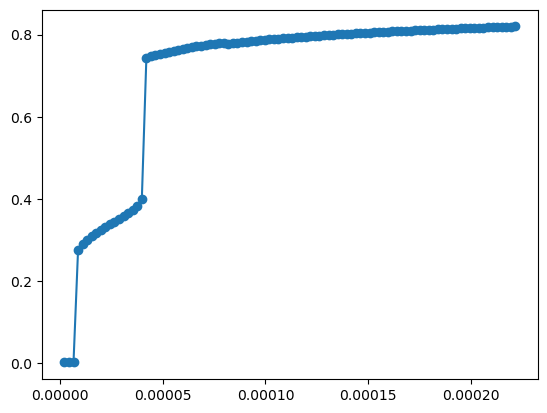

In [ ]:
plt.plot(P,Nads)
plt.scatter(P,Nads)
#plt.plot(P,rho_H)
plt.show()

### Below is an example for the evaluation of the desorption isotherm for argon on graphite:
### Here we simply need to change the order in which $\mu_H$ is fed into the algorithm.

0 2.214956392092312e-06 1e-07 0.8198379101475519
1 4.429912784184624e-06 1e-07 0.8194864771778493
2 6.644869176276936e-06 1e-07 0.8191122272187942
3 8.859825568369248e-06 1.3042211470195684e-05 0.8187360903277116
4 1.1074781960461561e-05 1.6306944257742688e-05 0.8183549760048008
5 1.3289738352553873e-05 1.957167704529143e-05 0.8179689305743567
6 1.5504694744646184e-05 2.28364098328367e-05 0.8175777503865024
7 1.7719651136738496e-05 2.610114262038544e-05 0.817181128495007
8 1.993460752883081e-05 2.9365875407934182e-05 0.8167791911852897
9 2.2149563920923125e-05 3.2630608195482926e-05 0.8163717208255994
10 2.436452031301543e-05 3.589534098303167e-05 0.8159583937193825
11 2.6579476705107745e-05 3.916007377057347e-05 0.8155393187092714
12 2.8794433097200057e-05 4.242480655812915e-05 0.8151142599638591
13 3.1009389489292375e-05 4.568953934567789e-05 0.8146828769637883
14 3.3224345881384676e-05 4.895427213323357e-05 0.8142452602827221
15 3.543930227347699e-05 5.221900492078925e-05 0.81380115

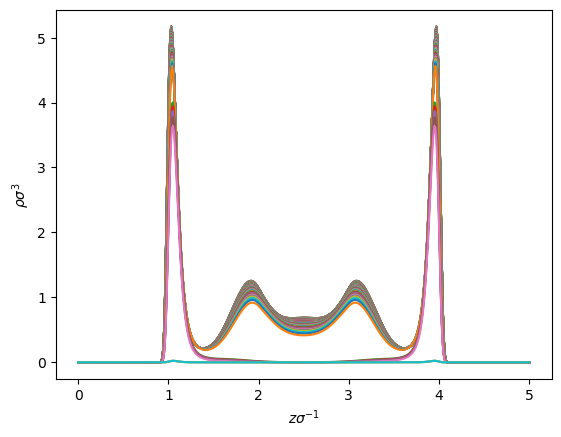

In [ ]:
Ndes = np.zeros(len(P))

for i in range(len(P)):
    #accuses the convergence of the method
    accu = 1

    #Tolerance
    tol = 1.e-7

    #mixing parameter
    alpha = 0.0009

    #tracking the iterations
    itera = 0

    while accu == 1:
        itera += 1
        dFhs = fmt.calc_dFHS(H, N_poid, rho_vec, Nump, dz, T, d_HS, Z_vec)
        dFatt = wca.calc_dFAtt(H,MF_poid,rho_vec,Nump,dz,Sigma_ff,
                               Eps_kb,Z_vec,rc_MF)
        rho_vec_new = np.exp(mu_H[len(P)-i-1]/T-Vext_vec/T-dFhs/T-dFatt/T)

        err = sum((rho_vec_new-rho_vec)**2)/(Nump)
        if (err<tol):
            accu = 0
        rho_vec = (1.-alpha)*rho_vec+alpha*rho_vec_new
        #print(err)
        if err<0.01:
            alpha = 0.02
    Ndes[i] = integrate.trapz(rho_vec,Z_vec)/(H-Sigma_sf)
    print(i,P[i],rho_H[i],Ndes[i])
    #rho_H_vec = np.zeros((Nump))+rho_H[i]
    plt.plot(Z_vec,rho_vec,label="P ="+str(P[i]))
    #plt.plot(Z_vec,rho_H_vec)
plt.ylabel(r"$\rho \sigma^3$")
plt.xlabel("$z \sigma^{-1}$")
plt.show()

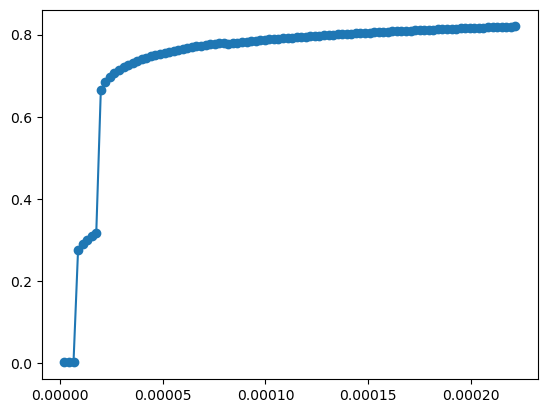

In [ ]:
plt.plot(P[::-1],Ndes)
plt.scatter(P[::-1],Ndes)
#plt.plot(P,rho_H)
plt.show()